In [ ]:
!pip3 install --upgrade tensorflow-addons

Requirement already up-to-date: tensorflow-addons in /usr/local/lib/python3.6/dist-packages (0.11.2)


In [ ]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
import cv2
from keras.utils import to_categorical  # Only for categorical one hot encoding
from tensorflow.keras import layers
from sklearn.metrics import accuracy_score
import tensorflow_datasets as tfds
import tensorflow_addons as tfa
from tensorflow.keras import backend as K
import time

In [ ]:
lfw = tfds.load('lfw', split='train', shuffle_files=True)

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [ ]:
def plotImages(imgs):
    fig = plt.figure(figsize=(8, 8))
 
    for i in range(imgs.shape[0]):
      plt.subplot(8, 8, i+1)
      plt.imshow(tf.cast(imgs[i, :, :, :] * 127.5 + 127.5, tf.uint8))
      plt.axis('off')
    plt.show()

In [ ]:
class EqualizeLearningRate(tf.keras.layers.Wrapper):
    """
    Reference from WeightNormalization implementation of TF Addons
    EqualizeLearningRate wrapper works for keras CNN and Dense (RNN not tested).
    ```python
      net = EqualizeLearningRate(
          tf.keras.layers.Conv2D(2, 2, activation='relu'),
          input_shape=(32, 32, 3),
          data_init=True)(x)
      net = EqualizeLearningRate(
          tf.keras.layers.Conv2D(16, 5, activation='relu'),
          data_init=True)(net)
      net = EqualizeLearningRate(
          tf.keras.layers.Dense(120, activation='relu'),
          data_init=True)(net)
      net = EqualizeLearningRate(
          tf.keras.layers.Dense(n_classes),
          data_init=True)(net)
    ```
    Arguments:
      layer: a layer instance.
    Raises:
      ValueError: If `Layer` does not contain a `kernel` of weights
    """

    def __init__(self, layer, **kwargs):
        super(EqualizeLearningRate, self).__init__(layer, **kwargs)
        self._track_trackable(layer, name='layer')
        self.is_rnn = isinstance(self.layer, tf.keras.layers.RNN)

    def build(self, input_shape):
        """Build `Layer`"""
        input_shape = tf.TensorShape(input_shape)
        self.input_spec = tf.keras.layers.InputSpec(
            shape=[None] + input_shape[1:])

        if not self.layer.built:
            self.layer.build(input_shape)

        kernel_layer = self.layer.cell if self.is_rnn else self.layer

        if not hasattr(kernel_layer, 'kernel'):
            raise ValueError('`EqualizeLearningRate` must wrap a layer that'
                             ' contains a `kernel` for weights')

        if self.is_rnn:
            kernel = kernel_layer.recurrent_kernel
        else:
            kernel = kernel_layer.kernel

        # He constant
        self.fan_in, self.fan_out= self._compute_fans(kernel.shape)
        self.he_constant = tf.Variable(1.0 / np.sqrt(self.fan_in), dtype=tf.float32, trainable=False)

        self.v = kernel
        self.built = True
    
    def call(self, inputs, training=True):
        """Call `Layer`"""

        with tf.name_scope('compute_weights'):
            # Multiply the kernel with the he constant.
            kernel = tf.identity(self.v * self.he_constant)
            
            if self.is_rnn:
                print(self.is_rnn)
                self.layer.cell.recurrent_kernel = kernel
                update_kernel = tf.identity(self.layer.cell.recurrent_kernel)
            else:
                self.layer.kernel = kernel
                update_kernel = tf.identity(self.layer.kernel)

            # Ensure we calculate result after updating kernel.
            with tf.control_dependencies([update_kernel]):
                outputs = self.layer(inputs)
                return outputs

    def compute_output_shape(self, input_shape):
        return tf.TensorShape(
            self.layer.compute_output_shape(input_shape).as_list())
    
    def _compute_fans(self, shape, data_format='channels_last'):
        """
        From Official Keras implementation
        Computes the number of input and output units for a weight shape.
        # Arguments
            shape: Integer shape tuple.
            data_format: Image data format to use for convolution kernels.
                Note that all kernels in Keras are standardized on the
                `channels_last` ordering (even when inputs are set
                to `channels_first`).
        # Returns
            A tuple of scalars, `(fan_in, fan_out)`.
        # Raises
            ValueError: in case of invalid `data_format` argument.
        """
        if len(shape) == 2:
            fan_in = shape[0]
            fan_out = shape[1]
        elif len(shape) in {3, 4, 5}:
            # Assuming convolution kernels (1D, 2D or 3D).
            # TH kernel shape: (depth, input_depth, ...)
            # TF kernel shape: (..., input_depth, depth)
            if data_format == 'channels_first':
                receptive_field_size = np.prod(shape[2:])
                fan_in = shape[1] * receptive_field_size
                fan_out = shape[0] * receptive_field_size
            elif data_format == 'channels_last':
                receptive_field_size = np.prod(shape[:-2])
                fan_in = shape[-2] * receptive_field_size
                fan_out = shape[-1] * receptive_field_size
            else:
                raise ValueError('Invalid data_format: ' + data_format)
        else:
            # No specific assumptions.
            fan_in = np.sqrt(np.prod(shape))
            fan_out = np.sqrt(np.prod(shape))
        return fan_in, fan_out

class PixelNorm(layers.Layer):
  def __init__(self, epsilon=1e-8, name=''):
    if name != '':
      super(PixelNorm, self).__init__(name=name)
    else:
      super(PixelNorm, self).__init__()
    self.epsilon = tf.constant(epsilon, dtype=tf.float32)
  
  def call(self, x):
    return x * tf.math.rsqrt(tf.reduce_mean(tf.math.square(x), axis=-1, keepdims=True) + self.epsilon)

  def get_config(self):
    config = {'name': self.name}
    base_config = super(PixelNorm, self).get_config()
    return dict(list(base_config.items()) + list(config.items()))

class FadeAdd(layers.Layer):
  def __init__(self):
    super(FadeAdd, self).__init__()
    self.alpha = tf.Variable(initial_value=0., trainable=False)
 
  def incrementAlpha(self, step=0.1):
    self.alpha.assign(tf.minimum(self.alpha+step, 1.))
    # print("New Alpha: ", self.alpha)
 
  def call(self, input):
    new, old = input
    self.alpha.assign(tf.minimum(self.alpha, 1.))
    return (new*self.alpha) + (old*(1-self.alpha))

class MinibatchStddev(layers.Layer):
  def __init__(self, group_size=4):
    super(MinibatchStddev, self).__init__()
    self.group_size = group_size

  def call(self, layer):
    group_size = tf.minimum(self.group_size, tf.shape(layer)[0])
    shape = tf.shape(layer)
    minibatch = tf.reshape(layer,(group_size, -1, shape[1], shape[2], shape[3]))
    minibatch -= tf.reduce_mean(minibatch, axis=0, keepdims=True)
    minibatch = tf.reduce_mean(tf.math.square(minibatch), axis = 0)
    minibatch = tf.math.sqrt(minibatch + 1e8)
    minibatch = tf.reduce_mean(minibatch, axis=[1,2, 3], keepdims=True)
    minibatch = tf.tile(minibatch,[group_size, shape[1], shape[2], 1]) 
    return K.concatenate([layer, minibatch], axis=-1)          # NHW1

fmap_base = 4096
fmap_max = 512
fmap_decay = 1.
def nf(stage): return min(int(fmap_base / (2.0 ** (stage * fmap_decay))), fmap_max)
# EqualizeLearningRate = tfa.layers.WeightNormalization


# class EqualizeLearningRate(layers.Layer):
#   def __init__(self, layer, name=''):
#     super(EqualizeLearningRate, self).__init__(name=name)
#     self.layer = layer
 
#   def call(self, input):
#     return self.layer(input)

#   def get_config(self):
#     config = {'name': self.name, 'layer':self.layer}
#     base_config = super(EqualizeLearningRate, self).get_config()
#     return dict(list(base_config.items()) + list(config.items()))


def generatorBase():
  resolution = 4
  res = int(np.log2(resolution))

  inputLayer = layers.Input((512))
  x = PixelNorm()(inputLayer)
  x = EqualizeLearningRate(layers.Dense(4*4*nf(res-1), use_bias=True, kernel_initializer='random_normal', activation='relu'))(x)
  x = layers.Reshape((4, 4, nf(res-1)))(x)
  x = PixelNorm()(x)

  x = EqualizeLearningRate(layers.Conv2D(nf(res-1), kernel_size=(3, 3), padding='same', kernel_initializer='he_uniform'))(x)
  x = layers.LeakyReLU(0.2)(x)
  x = PixelNorm(name='final_4')(x)

  out = EqualizeLearningRate(layers.Conv2D(3, (1, 1), strides=(1, 1), padding='same', use_bias=True, activation='linear', kernel_initializer='he_uniform'), name='out_4')(x)
  print(out.shape)
  model = tf.keras.models.Model(inputs=inputLayer, outputs=out)
  return model
 
def generatorAddStage(gen, resolution=8, freeze=False, initialAlpha=0):
  print("Current Shape: ", gen.output.shape)

  res = int(np.log2(resolution))
 
  if freeze:
    print("Freezing")
    gen.trainable = False
  
  newDepth = nf(res - 1)
  x = gen.get_layer('final_'+str(resolution // 2)).output
  print("Choosing layer ", x)
 
  print("New Depth: ", newDepth)
  
  x = layers.UpSampling2D(size=(2,2), interpolation='nearest')(x)

  x = EqualizeLearningRate(layers.Conv2D(newDepth, (3, 3), strides=(1, 1), padding='same', use_bias=True, kernel_initializer='he_uniform'))(x)
  x = layers.LeakyReLU(0.2)(x)
  x = PixelNorm()(x)

  x = EqualizeLearningRate(layers.Conv2D(newDepth, (3, 3), strides=(1, 1), padding='same', use_bias=True, kernel_initializer='he_uniform'))(x)
  x = layers.LeakyReLU(0.2)(x)
  x = PixelNorm(name='final_'+str(resolution))(x)
 
  out = EqualizeLearningRate(layers.Conv2D(3, (1, 1), strides=(1, 1), padding='same', use_bias=True, 
                                           activation='linear', kernel_initializer='he_uniform'), name='out_'+str(resolution))(x)
  print("New Shape: ", out.shape)
 
  # Add prev output
  lastOut = gen.get_layer('out_'+str(resolution // 2)).output
  up = layers.UpSampling2D((2,2), interpolation='nearest')(lastOut)
 
  alpha = FadeAdd()
  out = alpha([out, up])
 
  inputLayer = gen.input
  model = tf.keras.models.Model(inputs=inputLayer, outputs=out)
  return model, alpha
 
def changeGenAlpha(gen, alpha, step=0.1):
  newAlpha = alpha + step
  out = gen.layers[-1]
 
def reBaseModel(layers, inpTensor):
  layer = inpTensor
  # print("Rebasing")
  for i in range(len(layers)):
    # print(layer)
    layer = layers[i](layer)
  # print("Done")
  return layer

EqualizeLearningRate = tfa.layers.WeightNormalization

def descriminatorBase():
  resolution = 4
  res = int(np.log2(resolution))
  
  inputLayer = layers.Input((4, 4, 3))
  # x = tf.keras.layers.GaussianNoise(0.00)(inputLayer)
  x = inputLayer

  x = EqualizeLearningRate(tf.keras.layers.Conv2D(nf(res-1), (1, 1), padding='same', kernel_initializer='he_uniform'), name='sup_conv_4')(x)
  # x = tf.keras.layers.BatchNormalization(name='sup_bn_4')(x)
  x = tf.keras.layers.LeakyReLU(0.2, name='sup_act_4')(x)

  # x = reBaseModel(processingLayers, x)
 
  baseLayers = []
  baseLayers.append(MinibatchStddev())

  baseLayers.append(
      tfa.layers.SpectralNormalization(
          layers.Conv2D(nf(res-1), kernel_size=(3, 3), 
                        strides=(1, 1), padding='same', kernel_initializer='he_uniform'), 
                        name='depth_4'
          )
  )
  # baseLayers.append(layers.BatchNormalization(momentum=0.8))
  baseLayers.append(layers.LeakyReLU(0.2))
 
  baseLayers.append(layers.Flatten())

  # baseLayers.append(
  #     tfa.layers.SpectralNormalization(
  #         layers.Dense(nf(res-2), kernel_initializer='he_uniform'))
  # )
  baseLayers.append(layers.LeakyReLU(0.2))

  baseLayers.append(
      tfa.layers.SpectralNormalization(
          layers.Dense(1, kernel_initializer='he_uniform'))
  )

  encOut = reBaseModel(baseLayers[:-1], x)
  desOut = reBaseModel(baseLayers, x)
 
  dis = tf.keras.models.Model(inputs=inputLayer, outputs=desOut)
  enc = tf.keras.models.Model(inputs=inputLayer, outputs=encOut)
  return dis, enc, baseLayers
 
def descriminatorAddStage(des, enc, baseLayers, resolution=8, freeze=False):
  print("Current Shape: ", enc.input.shape)
 
  if freeze:
    print("Freezing")
    des.trainable = False
    enc.trainable = False
 
  print("Previous Input layer ", enc.input)
    
  newSize = resolution
 
  res = int(np.log2(resolution))

  print("New input ", newSize, newSize)
 
  inputLayer = layers.Input((newSize, newSize, 3))
  # inp = tf.keras.layers.GaussianNoise(0.00)(inputLayer) 
  inp = inputLayer

  processingLayers = []
  processingLayers.append(EqualizeLearningRate(tf.keras.layers.Conv2D(nf(res-1), (1, 1), padding='same', kernel_initializer='he_uniform'), name='sup_conv_'+str(resolution))
  )
  # processingLayers.append(tf.keras.layers.BatchNormalization(name='sup_bn_'+str(resolution)))
  processingLayers.append(tf.keras.layers.LeakyReLU(name='sup_act_'+str(resolution)))
  
  x = reBaseModel(processingLayers, inp)

  newLayers = []
  newLayers.append(EqualizeLearningRate(layers.Conv2D(nf(res-1), (3, 3), strides=(1, 1), padding='same', kernel_initializer='he_uniform'), name='depth_'+str(resolution)))
  # newLayers.append(layers.BatchNormalization(momentum=0.8))
  newLayers.append(layers.LeakyReLU())

  newLayers.append(EqualizeLearningRate(layers.Conv2D(nf(res-2), (3, 3), strides=(1, 1), padding='same', kernel_initializer='he_uniform'), name='depth2_'+str(resolution)))
  # newLayers.append(layers.BatchNormalization(momentum=0.8))
  newLayers.append(layers.LeakyReLU())
  newLayers.append(layers.AveragePooling2D(2, 2))
  
  newInp = reBaseModel(newLayers, x)
  # print(newInp, baseLayers)
 
  small = layers.AveragePooling2D((2, 2))(inp)
  sup = des.get_layer('sup_conv_'+str(resolution // 2))(small)
  # sup = des.get_layer('sup_bn_'+str(resolution // 2))(sup)
  sup = des.get_layer('sup_act_'+str(resolution // 2))(sup)

  print("====>", sup)
 
  print(newInp.shape, sup.shape)
  beta = FadeAdd()
  out = beta([newInp, sup])

  print("==>", out)
 
  desOut = reBaseModel(baseLayers, out)
  encOut = reBaseModel(baseLayers[:-1], out)
 
  des = tf.keras.models.Model(inputs=inputLayer, outputs=desOut)
  enc = tf.keras.models.Model(inputs=inputLayer, outputs=encOut)
 
  baseLayers = newLayers + baseLayers
  return des, enc, baseLayers, beta
 
def generateBaseModels():
  gen = generatorBase()
  des, enc, baseLayers = descriminatorBase()
  return gen, des, enc, baseLayers

In [ ]:
gen, des, enc, baseLayers = generateBaseModels()

(None, 4, 4, 3)


In [ ]:
!nvidia-smi

Wed Oct 28 06:11:32 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 455.23.05    Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla V100-SXM2...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   35C    P0    37W / 300W |    563MiB / 16130MiB |      0%      Default |
|                               |                      |                 ERR! |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
def lerp(a, b, t):
    return a + (b - a) * t

def discriminator_loss(real_output, fake_output, wgan_target=1., wgan_lambda=10.):
    wgan_loss = fake_output - real_output
    return wgan_loss

def descriminator_WGANGPloss(reals, fakes, des, batch_size, apply_penalty=True, wgan_target=1., wgan_lambda=10., wgan_epsilon=0.001):
    real_output = des(reals, training=True)
    fake_output = des(fakes, training=True)
    wgan_loss = discriminator_loss(real_output, fake_output)
    
    if apply_penalty:
      mixing_factors = tf.random.uniform([batch_size, 1, 1, 1], 0.0, 1.0, dtype=tf.float32)

      mixed_images = lerp(reals, fakes, mixing_factors)
      
      with tf.GradientTape() as gp_tape:
        gp_tape.watch(mixed_images)
        # 1. Get the discriminator output for this interpolated image.
        mixed_output = des(mixed_images, training=True)
        # mixed_loss = tf.reduce_sum(mixed_output)
        mixed_loss = mixed_output

      mixed_gradients = gp_tape.gradient(mixed_loss, [mixed_images])[0]
      mixed_norms = tf.sqrt(tf.reduce_sum(tf.math.square(mixed_gradients), axis=[1,2,3]))
      gradient_penalty = tf.math.square(mixed_norms - wgan_target)
      total_loss = wgan_loss + (gradient_penalty * (wgan_lambda / (wgan_target**2))) + wgan_epsilon*(tf.square(real_output))
    else:
      total_loss = wgan_loss
    return tf.reduce_mean(total_loss), real_output, fake_output
 
def generator_loss(fake_output):
    total_loss = -tf.reduce_mean(fake_output)
    return total_loss
 
def generator_enc_loss(real, fake):
  # return tf.reduce_mean(tf.abs(real - fake))
  return tf.abs(real - fake)#tf.keras.losses.mean_absolute_error(real, fake)

def generator_hinge_loss(fake_output):
  gen_loss = K.mean(fake_output)

def descriminator_hinge_loss(real, fakes, des, batch_size, apply_penalty=True, wgan_target=1., penalty_lambda=10):
  with tf.GradientTape() as gp_tape:
    gp_tape.watch(reals)
    real_output = des(reals, training=True)
    fake_output = des(fakes, training=True)

  divergence = K.mean(K.relu(1 + real_output) + K.relu(1 - fake_output))
  disc_loss = divergence

  if apply_penalty:
    gradient = gp_tape.gradient(real_output, [real])[0]
    penalty = K.mean(K.sum(tf.math.square(gradient), axis=np.arange(1, len(gradient.shape)))) * penalty_lambda
    disc_loss += penalty
  return disc_loss, real_output, fake_output

In [ ]:
# @tf.function
def trainGenEnc(gen, enc, real, batch_size, coeff=1, generator_optimizer=None, enc_optimizer=None):
  with tf.GradientTape() as enc_tape, tf.GradientTape() as gen_tape:
    real_enc = enc(real, training=True)
    enc_fake = gen(real_enc, training=True)
 
    gen_loss = generator_enc_loss(real, enc_fake) * coeff
    gradients_of_generator = gen_tape.gradient(gen_loss, gen.trainable_variables)
    generator_optimizer.apply_gradients(zip(gradients_of_generator, gen.trainable_variables))
 
    # gradients_of_enc = enc_tape.gradient(gen_loss, enc.trainable_variables)
    # enc_optimizer.apply_gradients(zip(gradients_of_enc, enc.trainable_variables))
 
# @tf.function
def trainDes(gen, des, real, batch_size, hinge=False, discriminator_optimizer=None):
  with tf.GradientTape() as disc_tape:
    noise = tf.random.normal([batch_size, 512])
 
    fake = gen(noise, training=False)
    
    if hinge:
      des_loss, real_output, fake_output = descriminator_hinge_loss(real, fake, des, batch_size)
    else:
      des_loss, real_output, fake_output = descriminator_WGANGPloss(real, fake, des, batch_size)

    gradients_of_discriminator = disc_tape.gradient(des_loss, des.trainable_variables)
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, des.trainable_variables))
 
# @tf.function
def trainDesGen(gen, des, real, batch_size, hinge=False, generator_optimizer=None, discriminator_optimizer=None):
  with tf.GradientTape() as disc_tape, tf.GradientTape() as gen_tape:
    noise = tf.random.normal([batch_size, 512])
    fake = gen(noise, training=True)
    
    if hinge:
      des_loss, real_output, fake_output = descriminator_hinge_loss(real, fake, des, batch_size)
      gen_loss = generator_hinge_loss(fake_output)
    else:
      des_loss, real_output, fake_output = descriminator_WGANGPloss(real, fake, des, batch_size)
      gen_loss = generator_loss(fake_output)
 
    gradients_of_discriminator = disc_tape.gradient(des_loss, des.trainable_variables)
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, des.trainable_variables))
 
    gradients_of_generator = gen_tape.gradient(gen_loss, gen.trainable_variables)
    generator_optimizer.apply_gradients(zip(gradients_of_generator, gen.trainable_variables))
 
# @tf.function
def trainGen(gen, des, batch_size, hinge=False, generator_optimizer=None):
  with tf.GradientTape() as gen_tape:
    noise = tf.random.normal([batch_size, 512])
 
    fake = gen(noise, training=True)
    fake_output = des(fake, training=False)
 
    if hinge:
      gen_loss = generator_hinge_loss(fake_output)
    else:
      gen_loss = generator_loss(fake_output)

    gradients_of_generator = gen_tape.gradient(gen_loss, gen.trainable_variables)
    generator_optimizer.apply_gradients(zip(gradients_of_generator, gen.trainable_variables))
 
def evalGan(gen, des, data, batches, batch_size):
  desAcc = 0
  genLoss = 0
  for i in range(batches):
    real = data
    fake = gen.predict(tf.random.normal([batch_size, 512]))
    X = tf.concat((fake, real), axis=0)
 
    output = des.predict(X)
 
    real_output = output[batch_size:]
    fake_output = output[:batch_size]
 
    labels = tf.reshape(tf.concat((tf.zeros_like(fake_output), tf.ones_like(real_output)), axis=0), [-1])
    output = tf.reshape(output, [-1])
    
    acc = tf.keras.metrics.binary_accuracy(labels, output, threshold=0.5)
    desAcc += acc.numpy()
    # print(acc)
    genLoss += tf.reduce_sum(generator_loss(fake_output)).numpy() / batch_size
  return desAcc / batches, genLoss / batches
 
from IPython.display import clear_output

def trainGan(data, name='A02', modeldir='/content/gdrive/My Drive/AI Research/GANs/models/', loadModel=None, epochs=10, 
             batchSize=5, loss='mse', hinge=False, sizes=[4, 8, 16, 32, 64, 128, 256], des_steps=1, gen_steps=1, enc_steps=1, grow=True,
             gen_alpha=None, des_alpha=None):
  global gen, des, enc, baseLayers
  realData = data
  # print(realData.shape)
  noise = tf.random.normal([64, 512])
  results = []

  generator_optimizer =  tfa.optimizers.Lookahead(tfa.optimizers.AdamW(weight_decay=1e-7, learning_rate=1e-4, beta_1 = 0, beta_2 = 0.999))
  discriminator_optimizer = tfa.optimizers.Lookahead(tfa.optimizers.AdamW(weight_decay=1e-7, learning_rate=1e-4, beta_1 = 0, beta_2 = 0.999))
  enc_optimizer = tfa.optimizers.Lookahead(tfa.optimizers.AdamW(weight_decay=5e-6, learning_rate=3e-4, beta_1 = 0, beta_2 = 0.999))

  def augmenter(size, alpha=None, method='nearest'):
    if alpha is not None:
      @tf.function
      def augment(sample):
        image = (tf.cast(sample['image'], tf.float32) - 127.5) / 127.5
        big = tf.image.resize(image, [size, size], method=method, antialias=True)
        small =  tf.image.resize(image, [size//2, size//2], method=method, antialias=True)
        small = tf.image.resize(small, [size, size], method='nearest')
        image = (big*alpha.alpha) + (small*(1-alpha.alpha))
        return {'image':image}
      return augment
    else:
      @tf.function
      def augment(sample):
        image = tf.image.resize(sample['image'], [size, size], method=method, antialias=True)
        image = (tf.cast(image, tf.float32) - 127.5) / 127.5
        return {'image':image}
      return augment

  for size in [4, 8, 16, 32, 64, 128, 256]:
    if max(sizes) < size:
      break
    batch_size = int((nf(int(np.log2(size)) - 2) / 512) * batchSize)
    print("Current Batch Size", batch_size)
    if loadModel == size:
      gen.load_weights(modeldir + name + '_' + str(size) + '_gen.h5')
      des.load_weights(modeldir + name + '_' + str(size)  + '_des.h5')
      enc.load_weights(modeldir + name + '_' + str(size)  + '_enc.h5')

    if size in sizes:
      print("Size", size)
      grow = True
      coeff = 0.5
      print("Input shape: ",des.input.shape)
      
      currentData = realData.map(augmenter(size)).batch(batch_size, drop_remainder=True).shuffle(4096).repeat().prefetch(tf.data.experimental.AUTOTUNE)
      REAL = next(iter(realData.map(augmenter(size)).batch(64)))['image']
      iterData = iter(currentData)

      def getTrainers():
        def _trainDes(real):
          trainDes(gen, des, real, batch_size, hinge, discriminator_optimizer)

        def _trainGen():
          trainGen(gen, des, batch_size, hinge, generator_optimizer)

        def _trainGenEnc(real, coeff):
          trainGenEnc(gen, enc, real, batch_size, coeff, generator_optimizer, enc_optimizer)

        def _trainGenDes(real):
          trainDesGen(gen, des, real, batch_size, hinge, generator_optimizer, discriminator_optimizer)

        return tf.function(_trainDes), tf.function(_trainGen), tf.function(_trainGenEnc), tf.function(_trainGenDes)
      
      _trainDes, _trainGen, _trainGenEnc, _trainGenDes = getTrainers()

      @tf.function
      def trainStep(batch):
          if des_alpha != None and gen_alpha != None:
            des_alpha.incrementAlpha(0.1 / ((220*60)/batch_size))
            gen_alpha.incrementAlpha(0.1 / ((220*60)/batch_size))
            
          batch = next(iterData)
          real = batch['image']

          for des_iter in range(des_steps):
            _trainDes(real)
          
          for gen_iter in range(gen_steps):
            _trainGen()
          
          _trainGenDes(real)

          for enc_iter in range(enc_steps):
            if coeff >= 0.15:
              _trainGenEnc(real, coeff)
            else:
              _trainGenEnc(real, 0.15)
      iters = (220*60) // batch_size
      for epoch in range(epochs):
        print("Running epoch ", epoch)
        t = time.time()
        for _ in range(iters):
          # print("Itering")
          try:
            trainStep(iterData)
          except Exception as e:
            print("Error in epoch ", epoch, e)
            _trainDes, _trainGen, _trainGenEnc, _trainGenDes = getTrainers()

        coeff *= 0.9

        fake = gen.predict(noise)
        real = REAL
        print("Evaluating:")
        desAcc, genLoss = evalGan(gen, des, real, 10, batch_size)
        results.append({'desAcc':desAcc, 'genLoss':genLoss})
        print("Epoch ", epoch, desAcc, genLoss, "of ", epochs, "Epochs")

        # print("epoch length: ", b)
        print("Real: ")
        plotImages(real)
  
        print("Fake: ")
        plotImages(fake)

        if desAcc > 0.8:
          coeff *= 2
          coeff = min(coeff, 1.)

        if des_alpha != None and gen_alpha != None:
          print("Alpha, Beta: ", gen_alpha.alpha, des_alpha.alpha)


      gen.save(modeldir + name + '_' + str(size) + '_gen.h5')
      des.save_weights(modeldir + name + '_' + str(size)  + '_des.h5')
      enc.save_weights(modeldir + name + '_' + str(size)  + '_enc.h5')
    
    if grow==True:
      des, enc, baseLayers, des_alpha = descriminatorAddStage(des, enc, baseLayers, resolution=size*2, freeze=False)
      gen, gen_alpha = generatorAddStage(gen, resolution=size*2, freeze=False)
    epochs *= 1.6
    epochs = int(epochs)
    clear_output(wait=True)

In [ ]:
global gen, des, enc, baseLayers
gen, des, enc, baseLayers = generateBaseModels()
trainGan(lfw, name='New02', epochs=10, batchSize=128, hinge=False, des_steps=2, gen_steps=0, enc_steps=0)

Current Batch Size 32
Size 128
Input shape:  (None, 128, 128, 3)
Running epoch  0


In [ ]:
des, enc, baseLayers, des_alpha = descriminatorAddStage(des, enc, baseLayers, resolution=64, freeze=False)
gen, gen_alpha = generatorAddStage(gen, resolution=64, freeze=False)

Current Shape:  (None, 32, 32, 3)
Previous Input layer  Tensor("input_44:0", shape=(None, 32, 32, 3), dtype=float32)
New input  64 64
====> Tensor("sup_act_32/LeakyRelu_2:0", shape=(None, 32, 32, 256), dtype=float32)
(None, 32, 32, 256) (None, 32, 32, 256)
==> Tensor("fade_add_22/add:0", shape=(None, 32, 32, 256), dtype=float32)
Current Shape:  (None, 32, 32, 3)
Choosing layer  Tensor("final_32/mul_2:0", shape=(None, 32, 32, 256), dtype=float32)
New Depth:  128
New Shape:  (None, 64, 64, 3)


In [ ]:
des_alpha = des.get_layer('fade_add_26')
gen_alpha = gen.layers[-1]

Current Batch Size 64
Size 64
Input shape:  (None, 64, 64, 3)
Running epoch  0
Evaluating:
Epoch  0 0.484375 0.10881921499967576 of  64 Epochs
Real: 


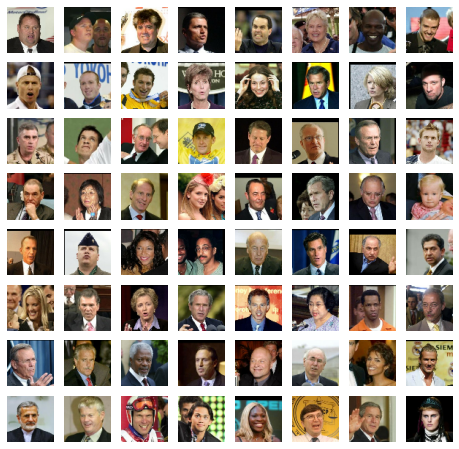

Fake: 


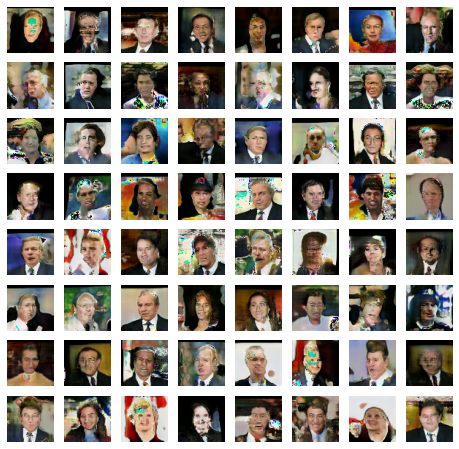

Alpha, Beta:  <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0> <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0>
Running epoch  1
Evaluating:
Epoch  1 0.5921875 0.01203646594658494 of  64 Epochs
Real: 


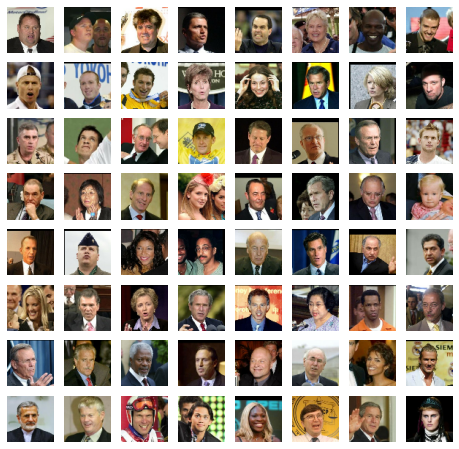

Fake: 


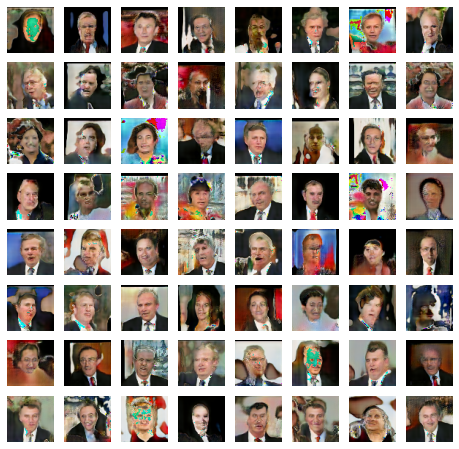

Alpha, Beta:  <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0> <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0>
Running epoch  2
Evaluating:
Epoch  2 0.5359375 0.07747594863176346 of  64 Epochs
Real: 


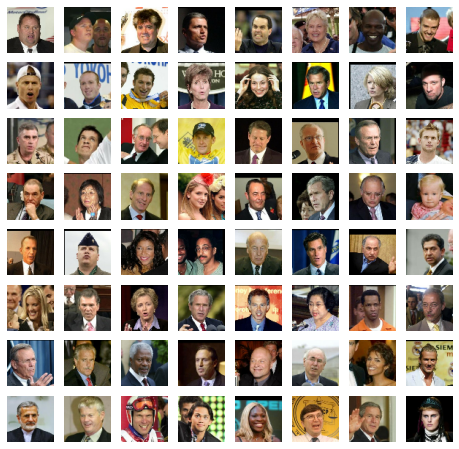

Fake: 


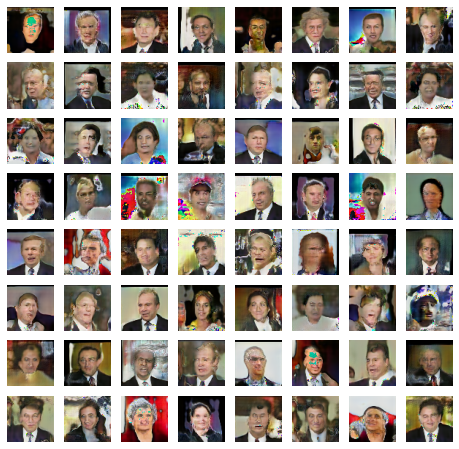

Alpha, Beta:  <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0> <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0>
Running epoch  3
Evaluating:
Epoch  3 0.490625 0.15731705874204635 of  64 Epochs
Real: 


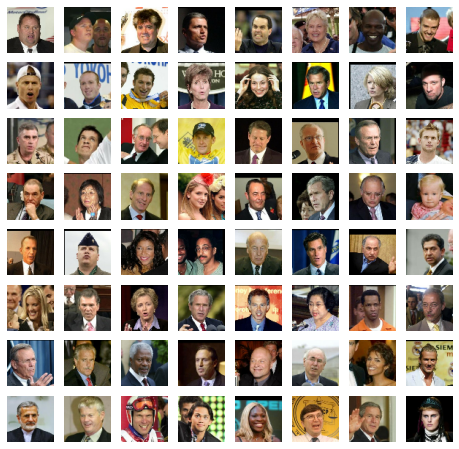

Fake: 


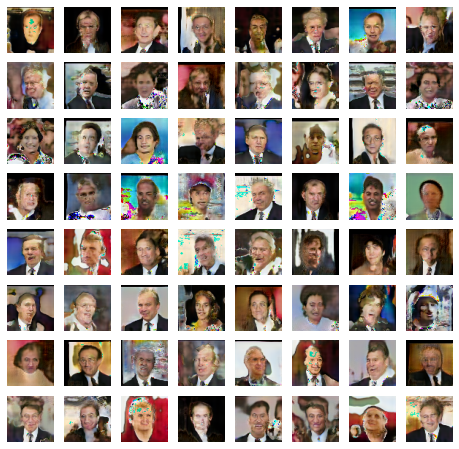

Alpha, Beta:  <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0> <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0>
Running epoch  4
Evaluating:
Epoch  4 0.56953125 0.05695356633514166 of  64 Epochs
Real: 


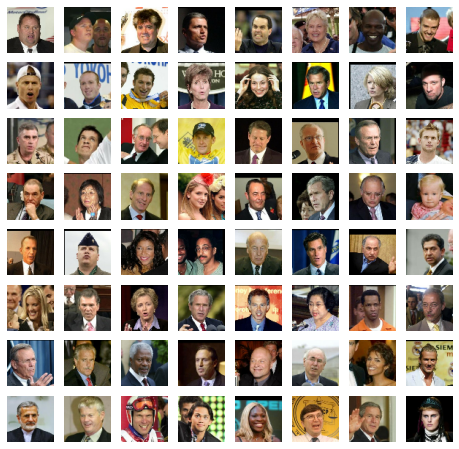

Fake: 


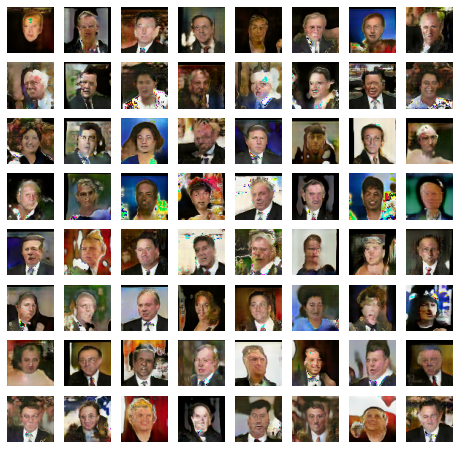

Alpha, Beta:  <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0> <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0>
Running epoch  5
Evaluating:
Epoch  5 0.51953125 0.12491182088851929 of  64 Epochs
Real: 


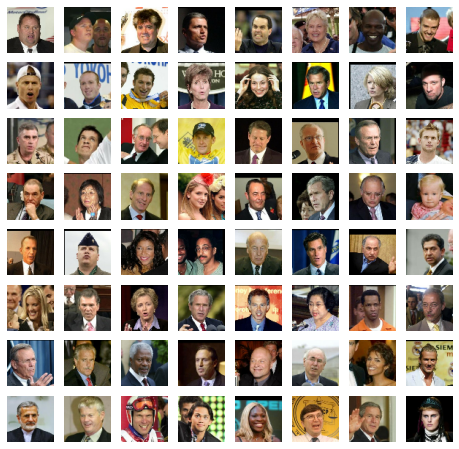

Fake: 


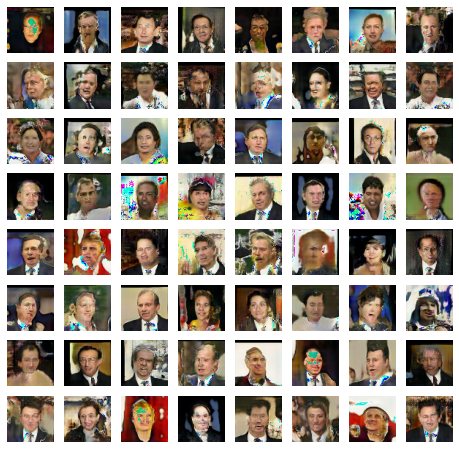

Alpha, Beta:  <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0> <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0>
Running epoch  6
Evaluating:
Epoch  6 0.5484375 0.04532029815018177 of  64 Epochs
Real: 


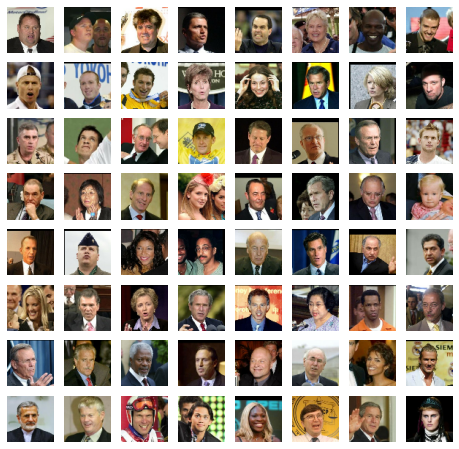

Fake: 


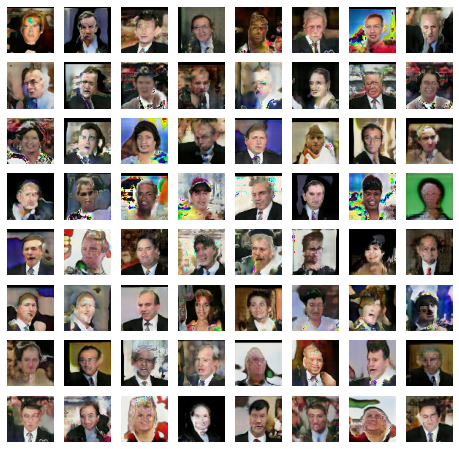

Alpha, Beta:  <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0> <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0>
Running epoch  7
Evaluating:
Epoch  7 0.53984375 0.13628233075141907 of  64 Epochs
Real: 


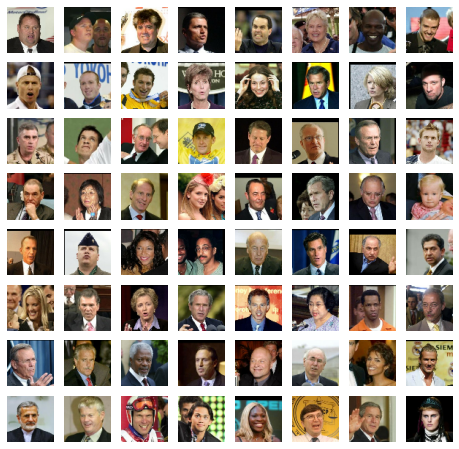

Fake: 


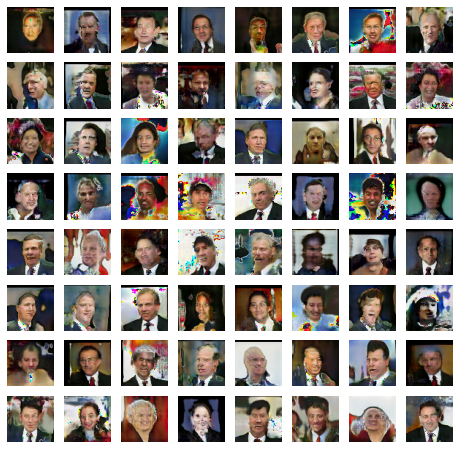

Alpha, Beta:  <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0> <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0>
Running epoch  8
Evaluating:
Epoch  8 0.55 0.07140515521168708 of  64 Epochs
Real: 


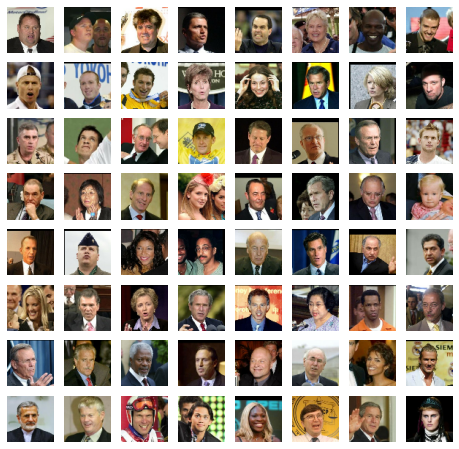

Fake: 


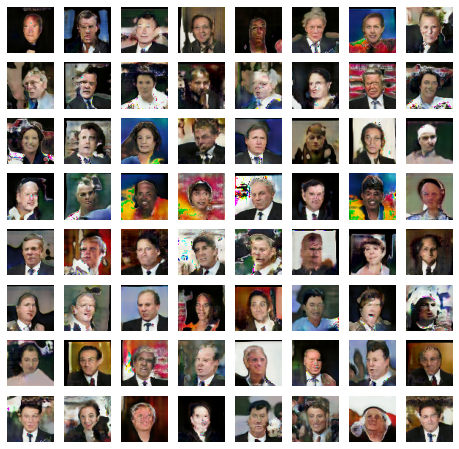

Alpha, Beta:  <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0> <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0>
Running epoch  9
Evaluating:
Epoch  9 0.54296875 0.10879896655678749 of  64 Epochs
Real: 


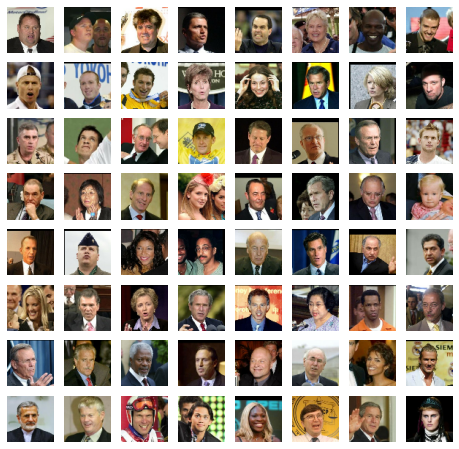

Fake: 


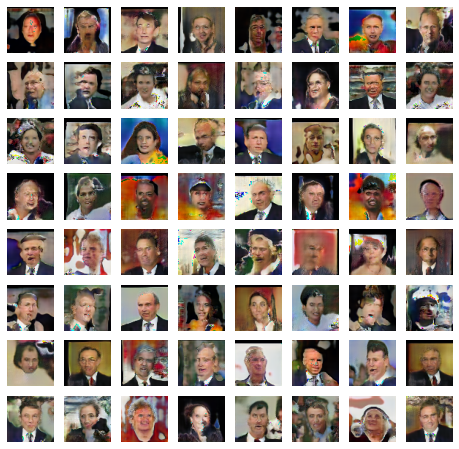

Alpha, Beta:  <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0> <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0>
Running epoch  10
Evaluating:
Epoch  10 0.52890625 0.07568559087812901 of  64 Epochs
Real: 


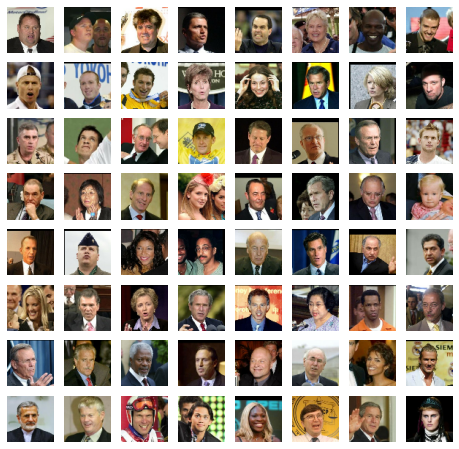

Fake: 


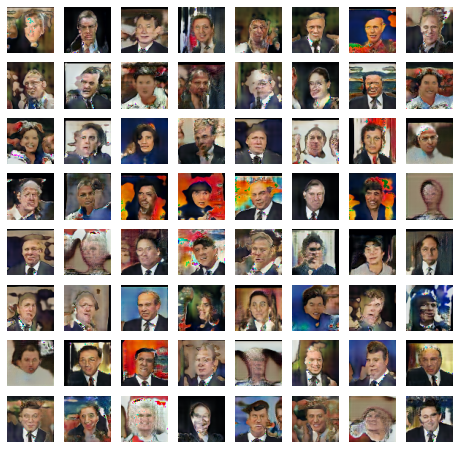

Alpha, Beta:  <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0> <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0>
Running epoch  11
Evaluating:
Epoch  11 0.5125 0.11543624326586724 of  64 Epochs
Real: 


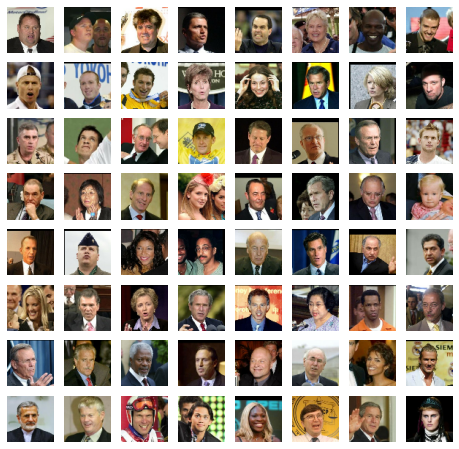

Fake: 


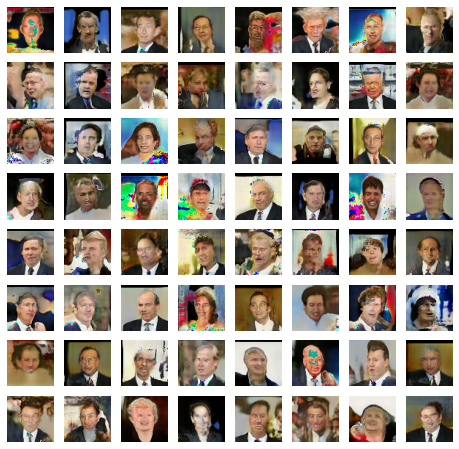

Alpha, Beta:  <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0> <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0>
Running epoch  12
Evaluating:
Epoch  12 0.515625 0.003028912702575326 of  64 Epochs
Real: 


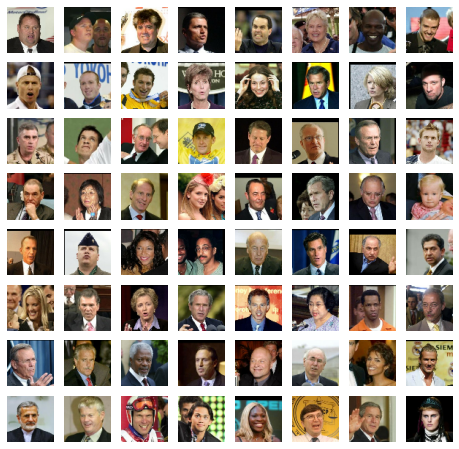

Fake: 


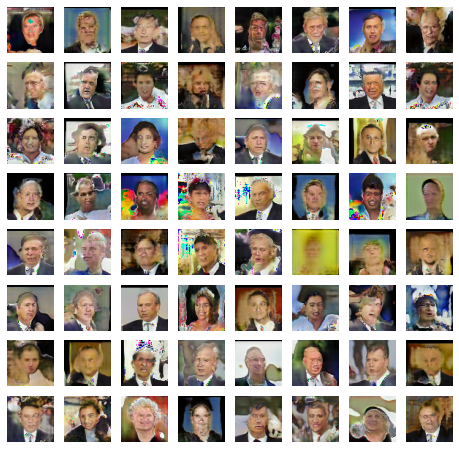

Alpha, Beta:  <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0> <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0>
Running epoch  13
Evaluating:
Epoch  13 0.51796875 0.05593175515532493 of  64 Epochs
Real: 


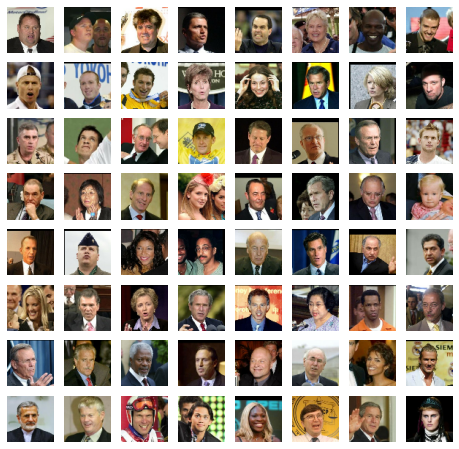

Fake: 


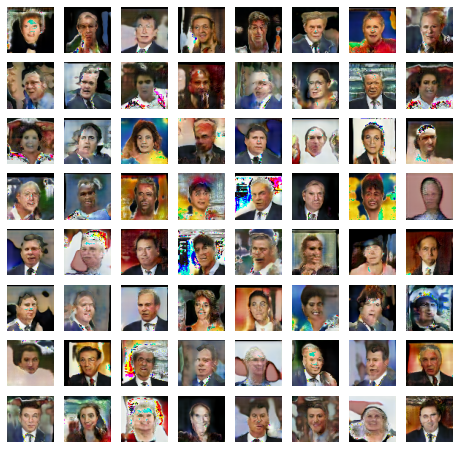

Alpha, Beta:  <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0> <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0>
Running epoch  14
Evaluating:
Epoch  14 0.584375 0.1001151829957962 of  64 Epochs
Real: 


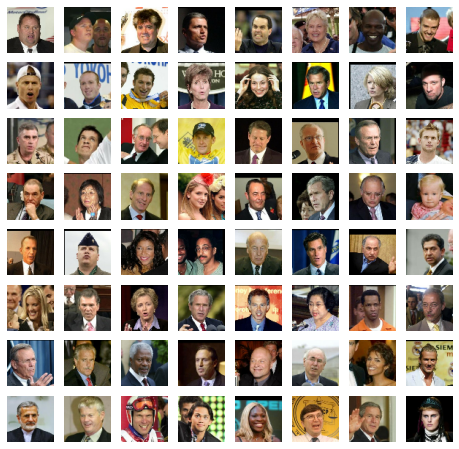

Fake: 


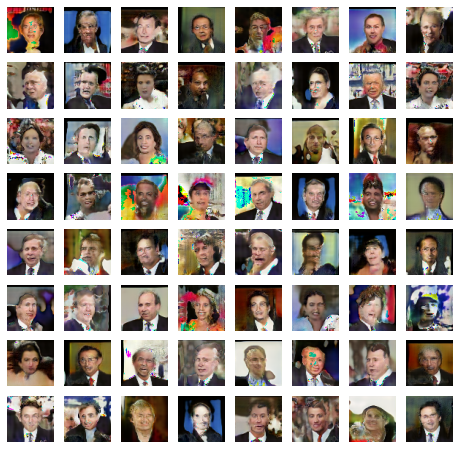

Alpha, Beta:  <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0> <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0>
Running epoch  15
Evaluating:
Epoch  15 0.5 0.3289008319377899 of  64 Epochs
Real: 


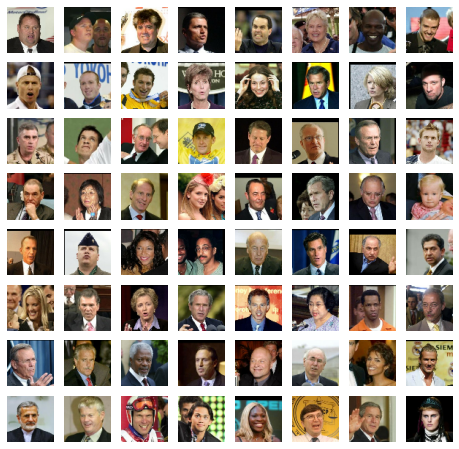

Fake: 


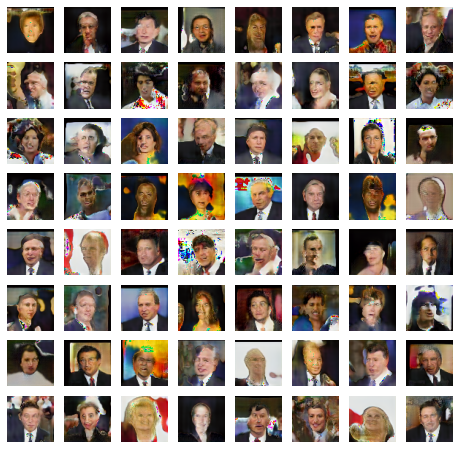

Alpha, Beta:  <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0> <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0>
Running epoch  16
Evaluating:
Epoch  16 0.49453125 0.2048713222146034 of  64 Epochs
Real: 


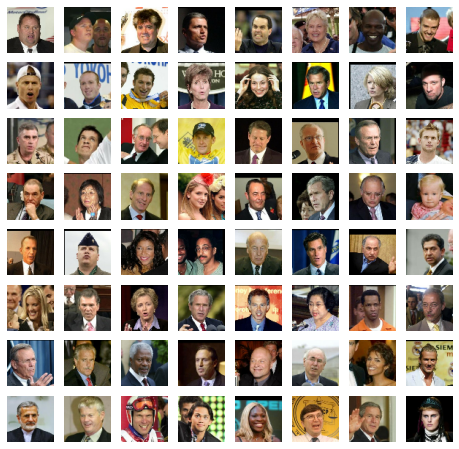

Fake: 


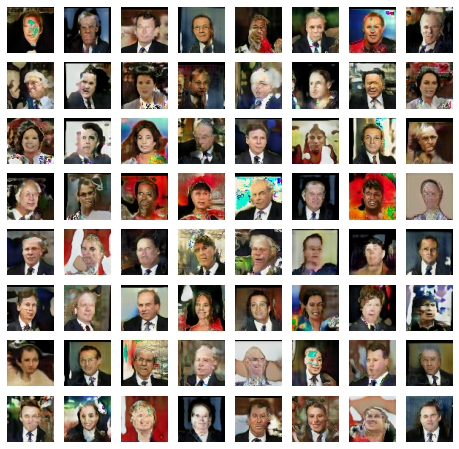

Alpha, Beta:  <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0> <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0>
Running epoch  17
Evaluating:
Epoch  17 0.61328125 -0.004760764830280095 of  64 Epochs
Real: 


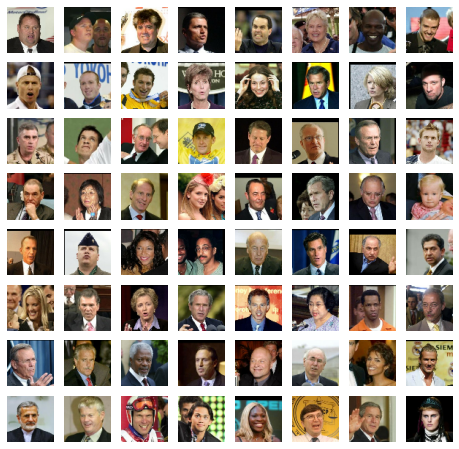

Fake: 


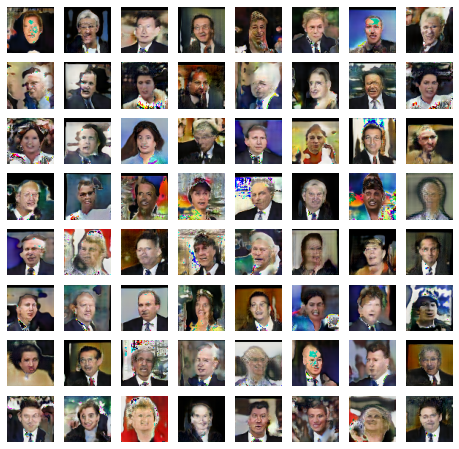

Alpha, Beta:  <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0> <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0>
Running epoch  18
Evaluating:
Epoch  18 0.5171875 -0.20331925004720688 of  64 Epochs
Real: 


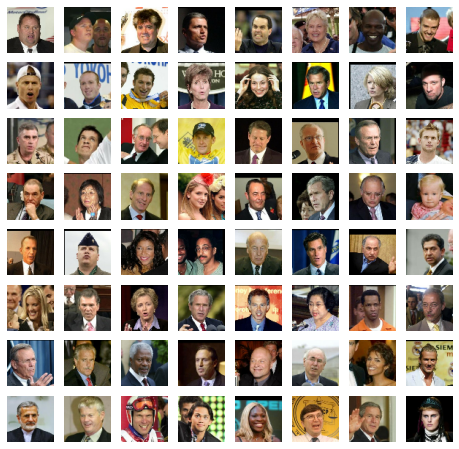

Fake: 


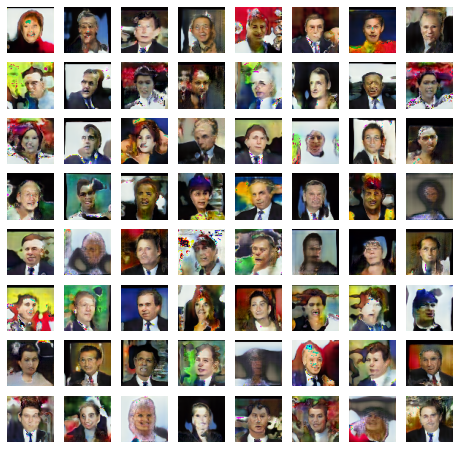

Alpha, Beta:  <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0> <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0>
Running epoch  19
Evaluating:
Epoch  19 0.5453125 0.09211282506585121 of  64 Epochs
Real: 


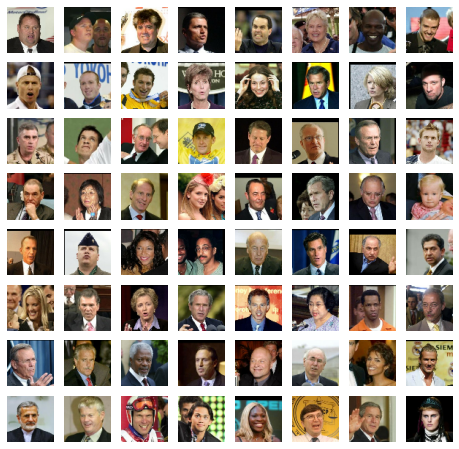

Fake: 


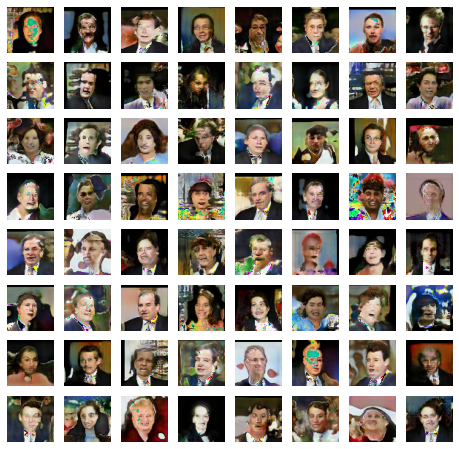

Alpha, Beta:  <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0> <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0>
Running epoch  20
Evaluating:
Epoch  20 0.4984375 0.17187452614307402 of  64 Epochs
Real: 


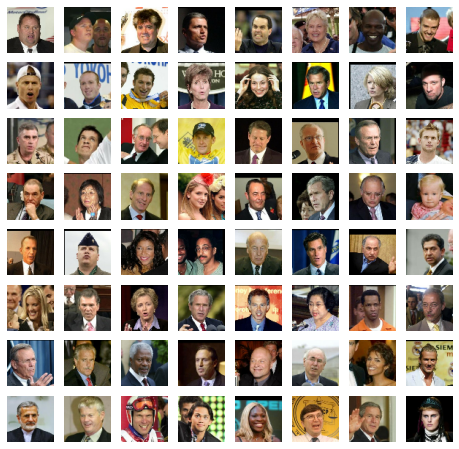

Fake: 


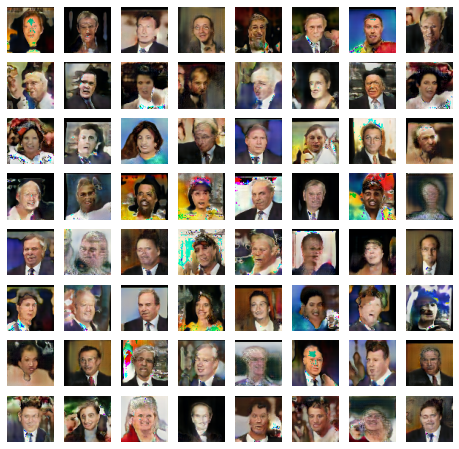

Alpha, Beta:  <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0> <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0>
Running epoch  21
Evaluating:
Epoch  21 0.5109375 -0.012627780297771096 of  64 Epochs
Real: 


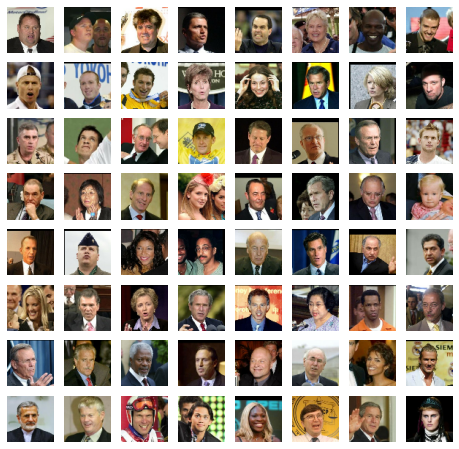

Fake: 


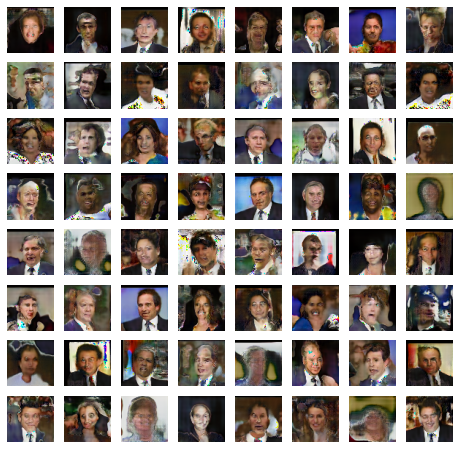

Alpha, Beta:  <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0> <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0>
Running epoch  22
Evaluating:
Epoch  22 0.53828125 0.2632231190800667 of  64 Epochs
Real: 


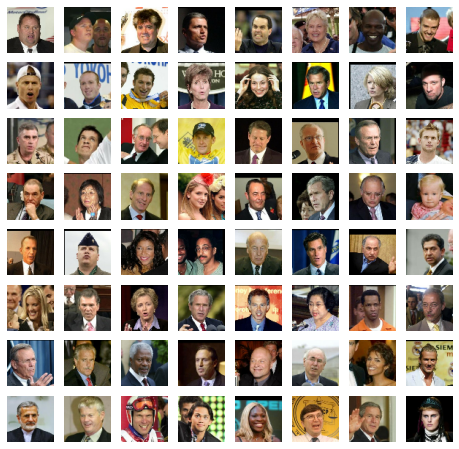

Fake: 


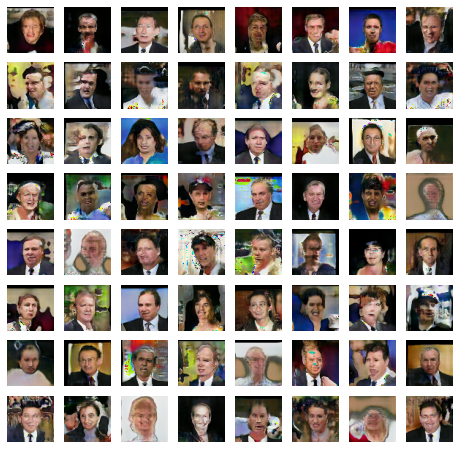

Alpha, Beta:  <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0> <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0>
Running epoch  23
Evaluating:
Epoch  23 0.55546875 0.10338506624102592 of  64 Epochs
Real: 


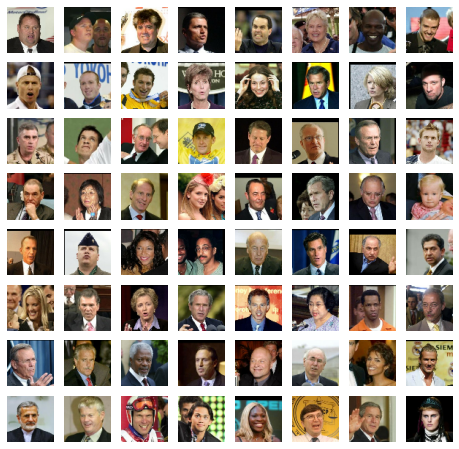

Fake: 


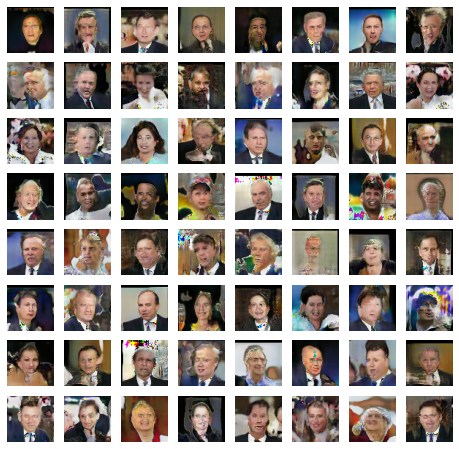

Alpha, Beta:  <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0> <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0>
Running epoch  24
Evaluating:
Epoch  24 0.53828125 -0.08900643736124039 of  64 Epochs
Real: 


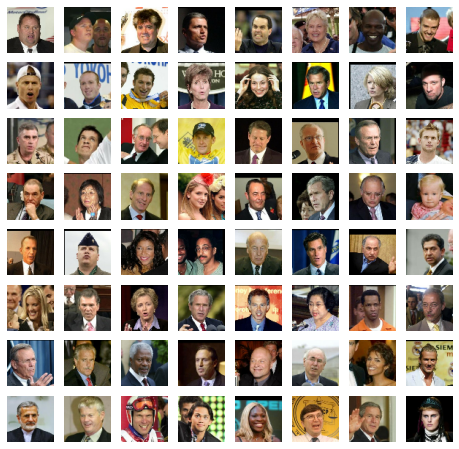

Fake: 


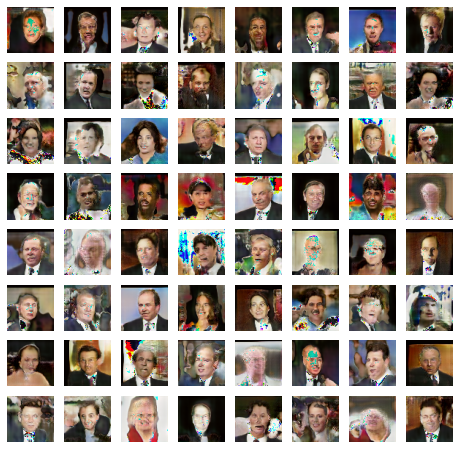

Alpha, Beta:  <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0> <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0>
Running epoch  25
Evaluating:
Epoch  25 0.55078125 0.009612797433510423 of  64 Epochs
Real: 


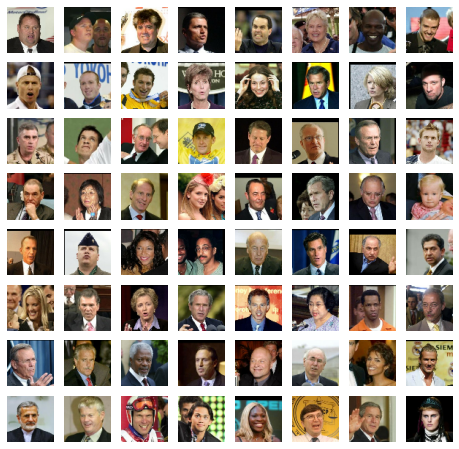

Fake: 


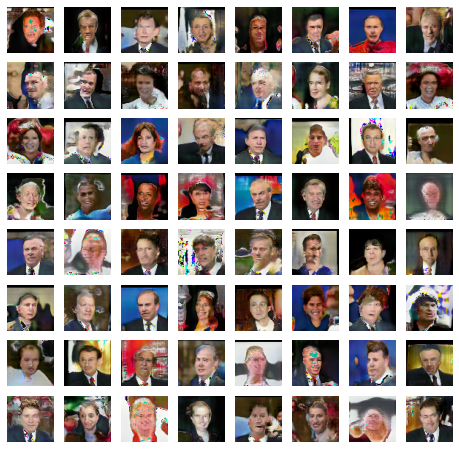

Alpha, Beta:  <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0> <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0>
Running epoch  26
Evaluating:
Epoch  26 0.59765625 -0.029082625359296798 of  64 Epochs
Real: 


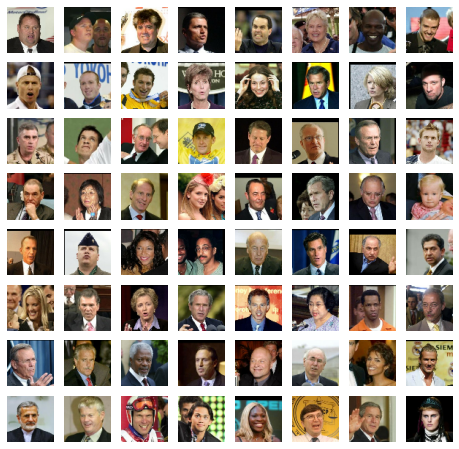

Fake: 


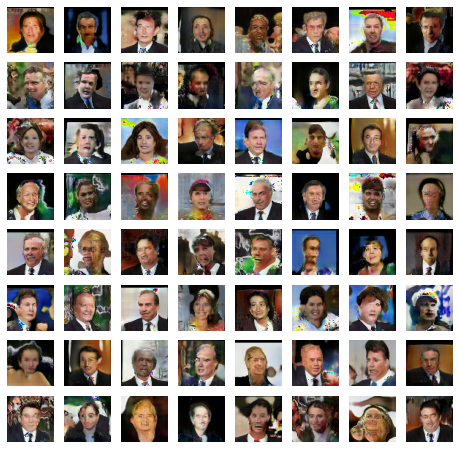

Alpha, Beta:  <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0> <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0>
Running epoch  27
Evaluating:
Epoch  27 0.4953125 0.2045688509941101 of  64 Epochs
Real: 


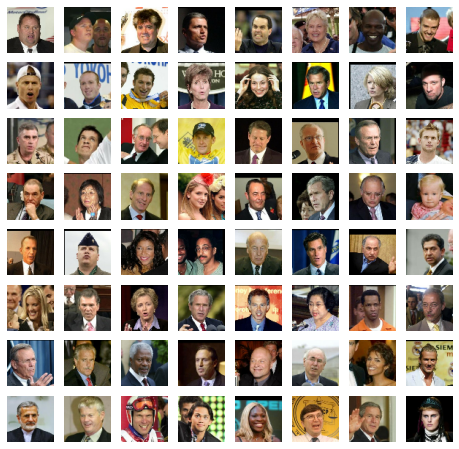

Fake: 


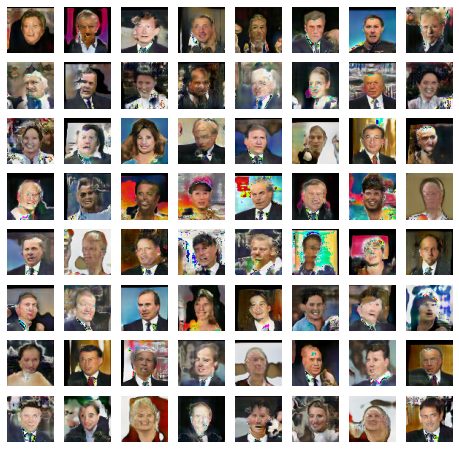

Alpha, Beta:  <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0> <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0>
Running epoch  28
Evaluating:
Epoch  28 0.54296875 0.17919133156538009 of  64 Epochs
Real: 


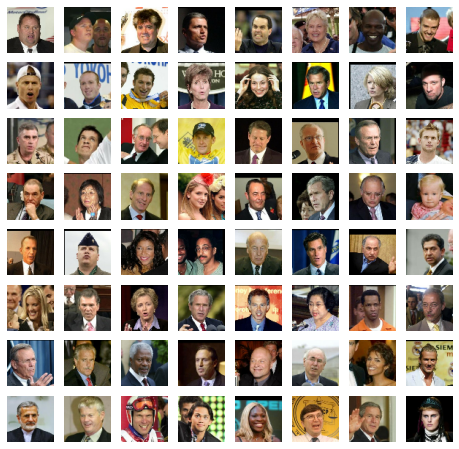

Fake: 


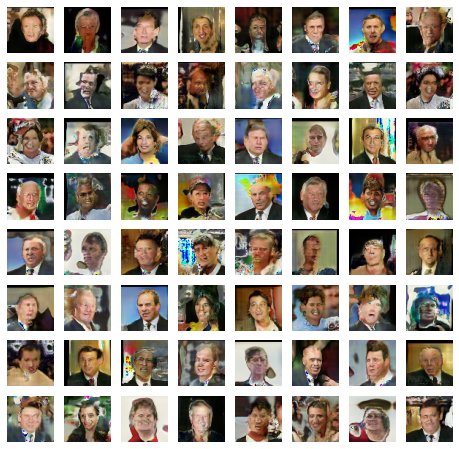

Alpha, Beta:  <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0> <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0>
Running epoch  29
Evaluating:
Epoch  29 0.50625 0.14370269179344178 of  64 Epochs
Real: 


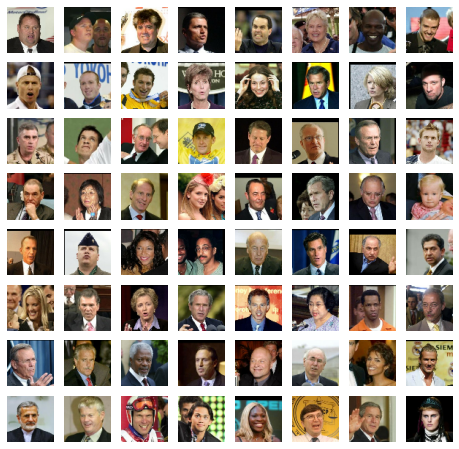

Fake: 


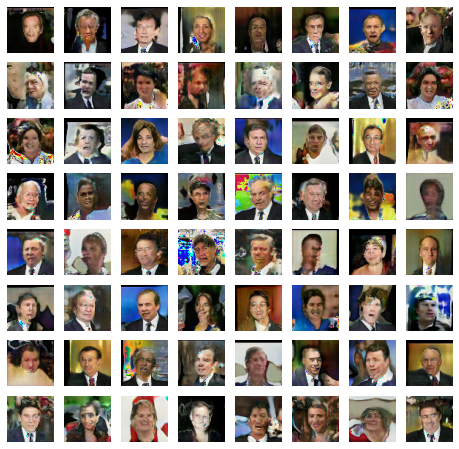

Alpha, Beta:  <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0> <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0>
Running epoch  30
Evaluating:
Epoch  30 0.45859375 0.1199650377035141 of  64 Epochs
Real: 


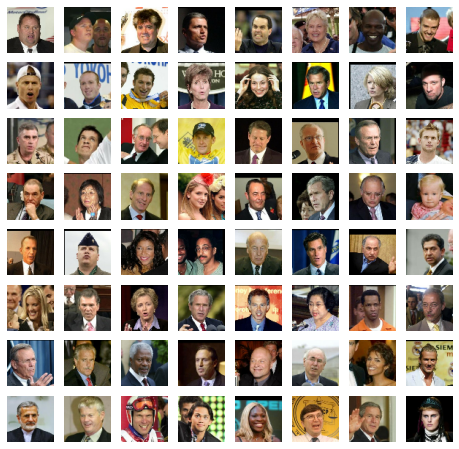

Fake: 


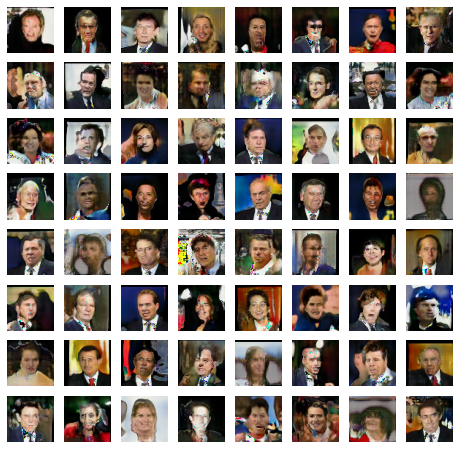

Alpha, Beta:  <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0> <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0>
Running epoch  31
Evaluating:
Epoch  31 0.5921875 0.13722012639045716 of  64 Epochs
Real: 


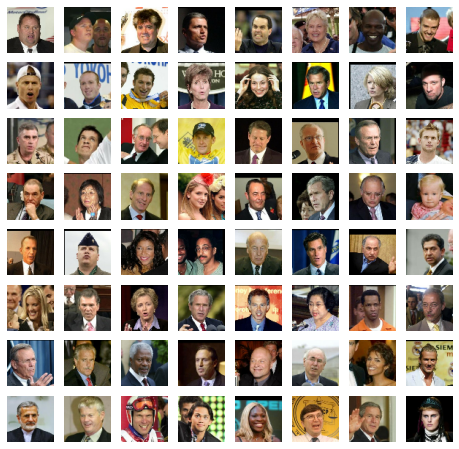

Fake: 


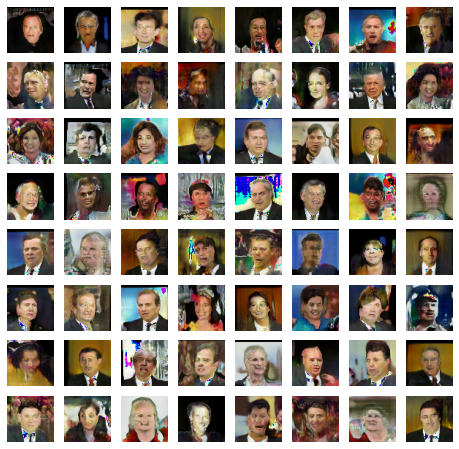

Alpha, Beta:  <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0> <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0>
Running epoch  32
Evaluating:
Epoch  32 0.50390625 0.16747070699930192 of  64 Epochs
Real: 


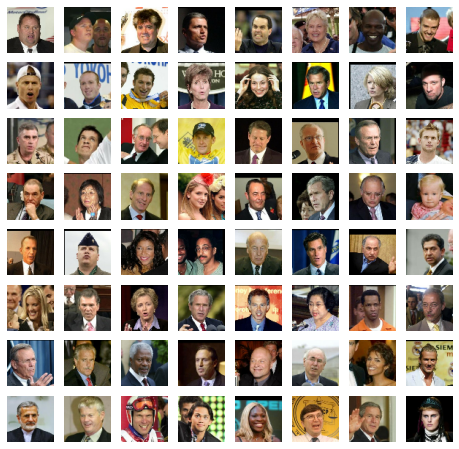

Fake: 


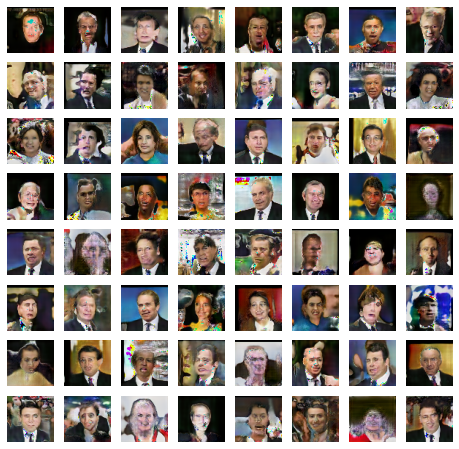

Alpha, Beta:  <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0> <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0>
Running epoch  33
Evaluating:
Epoch  33 0.525 0.09780405983328819 of  64 Epochs
Real: 


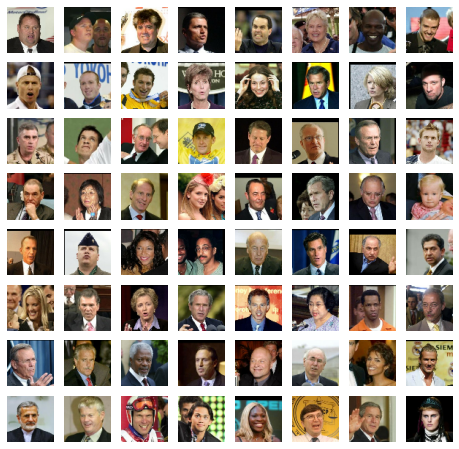

Fake: 


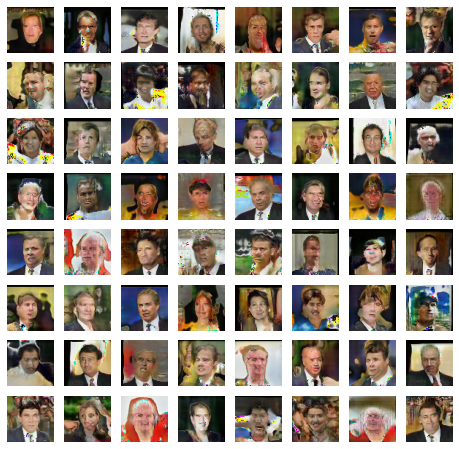

Alpha, Beta:  <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0> <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0>
Running epoch  34
Evaluating:
Epoch  34 0.5046875 0.2942309558391571 of  64 Epochs
Real: 


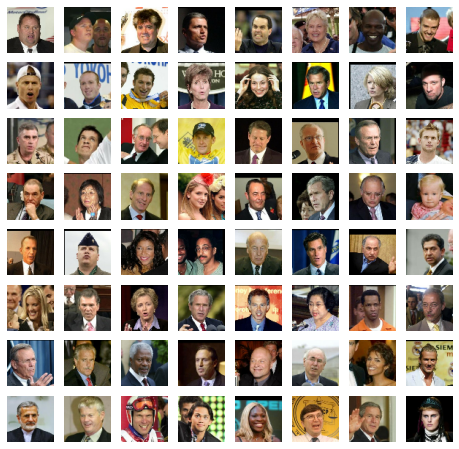

Fake: 


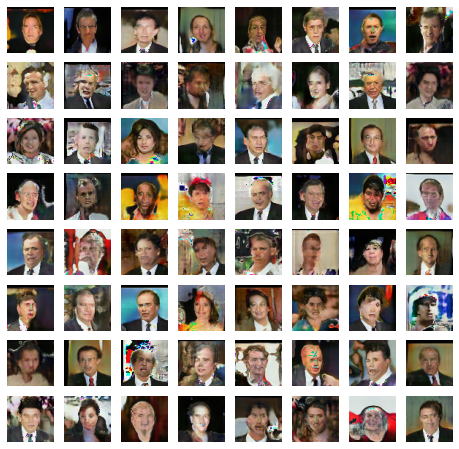

Alpha, Beta:  <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0> <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0>
Running epoch  35
Evaluating:
Epoch  35 0.59453125 0.05197293572127819 of  64 Epochs
Real: 


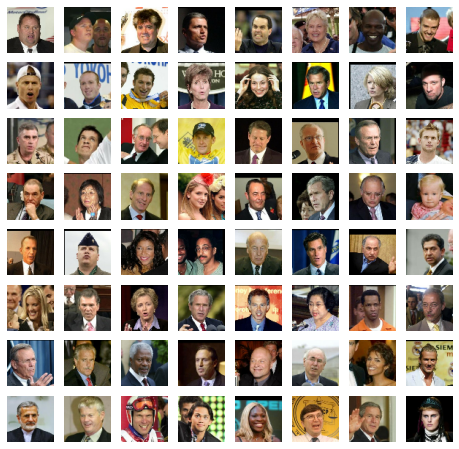

Fake: 


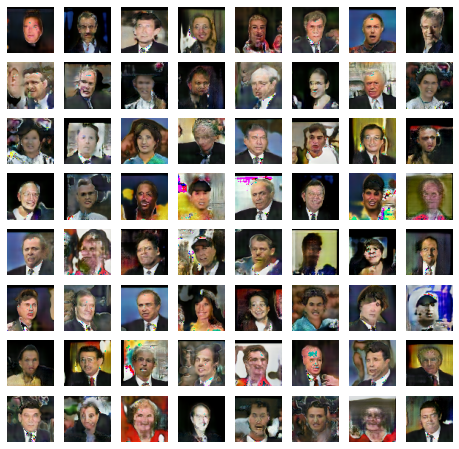

Alpha, Beta:  <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0> <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0>
Running epoch  36
Evaluating:
Epoch  36 0.51171875 0.26569225192070006 of  64 Epochs
Real: 


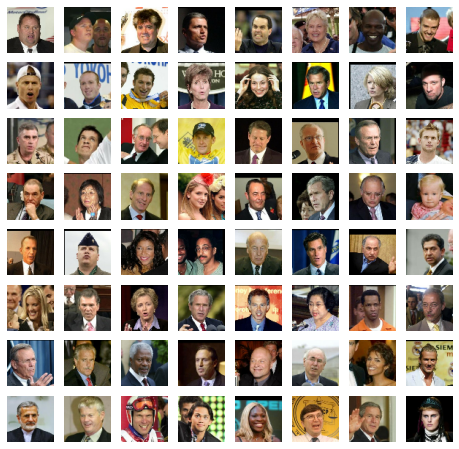

Fake: 


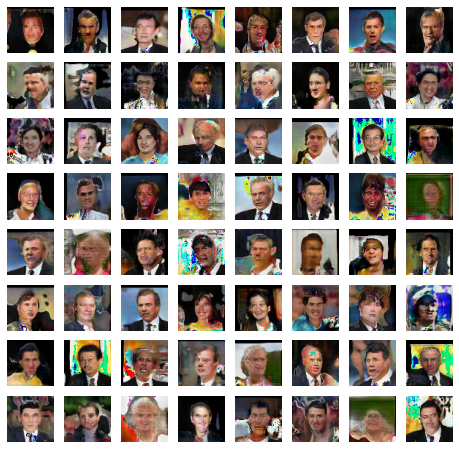

Alpha, Beta:  <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0> <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0>
Running epoch  37
Evaluating:
Epoch  37 0.490625 0.293975830078125 of  64 Epochs
Real: 


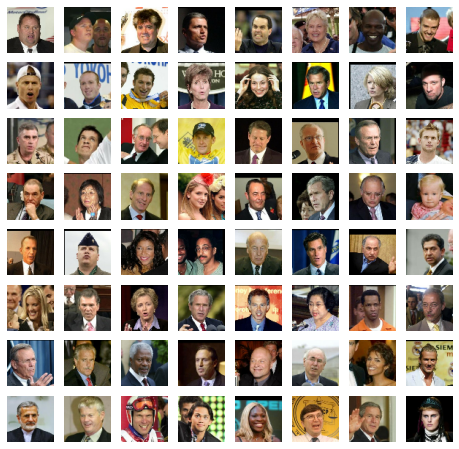

Fake: 


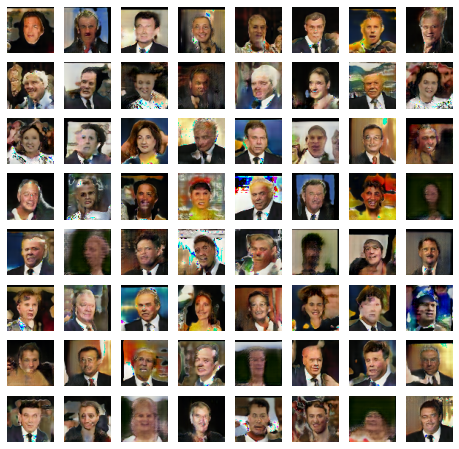

Alpha, Beta:  <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0> <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0>
Running epoch  38
Evaluating:
Epoch  38 0.5 0.22715598940849305 of  64 Epochs
Real: 


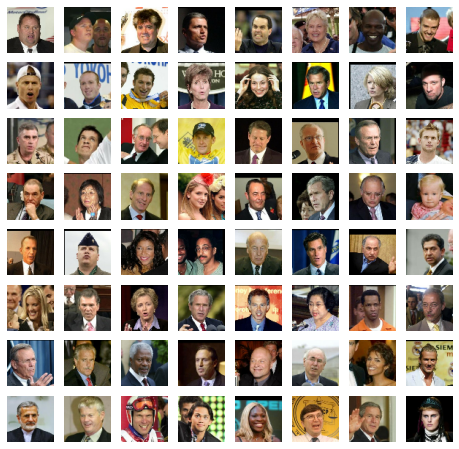

Fake: 


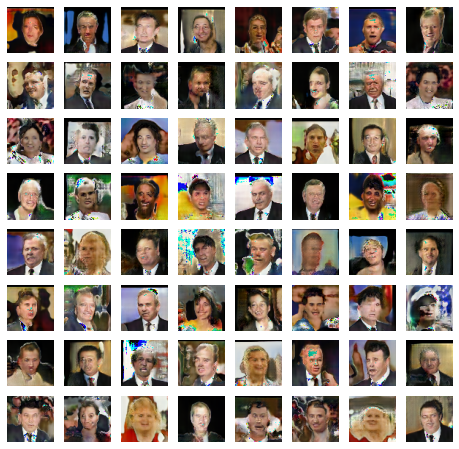

Alpha, Beta:  <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0> <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0>
Running epoch  39
Evaluating:
Epoch  39 0.5 0.11380616798996926 of  64 Epochs
Real: 


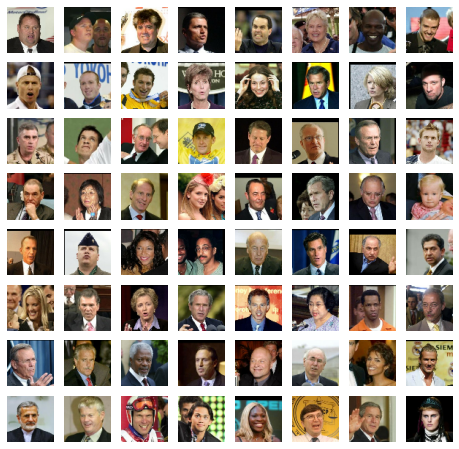

Fake: 


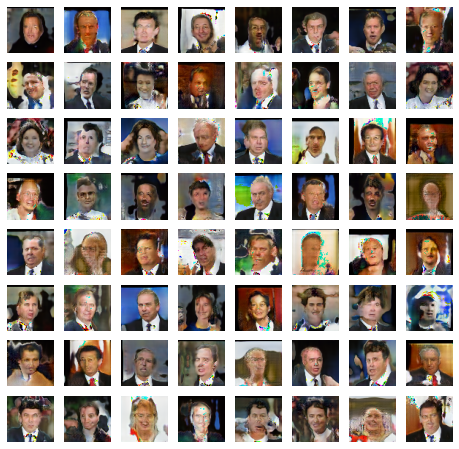

Alpha, Beta:  <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0> <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0>
Running epoch  40
Evaluating:
Epoch  40 0.5 0.30413336455821993 of  64 Epochs
Real: 


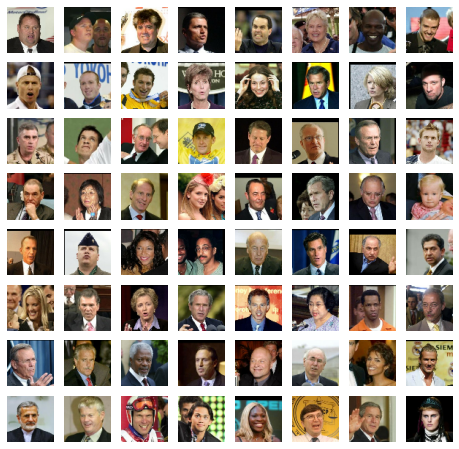

Fake: 


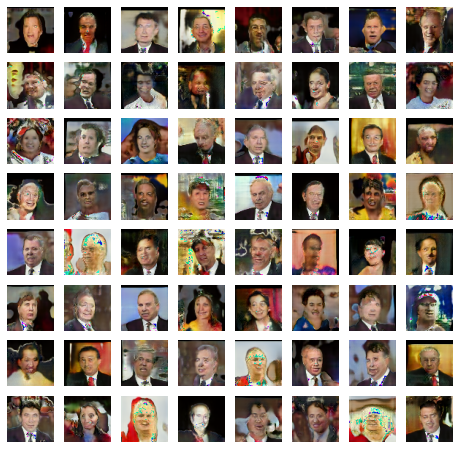

Alpha, Beta:  <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0> <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0>
Running epoch  41
Evaluating:
Epoch  41 0.5 0.26316403448581693 of  64 Epochs
Real: 


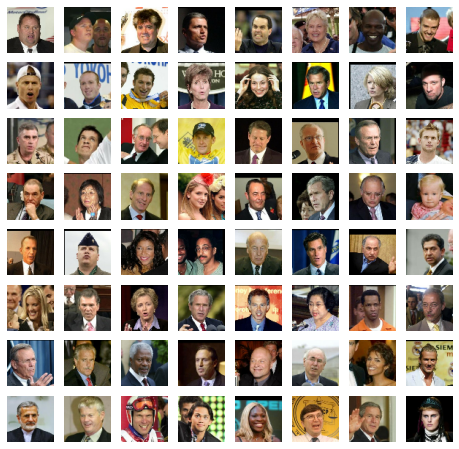

Fake: 


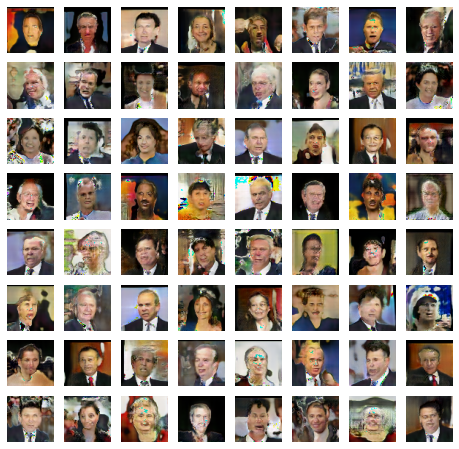

Alpha, Beta:  <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0> <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0>
Running epoch  42
Evaluating:
Epoch  42 0.43671875 0.0012524324469268323 of  64 Epochs
Real: 


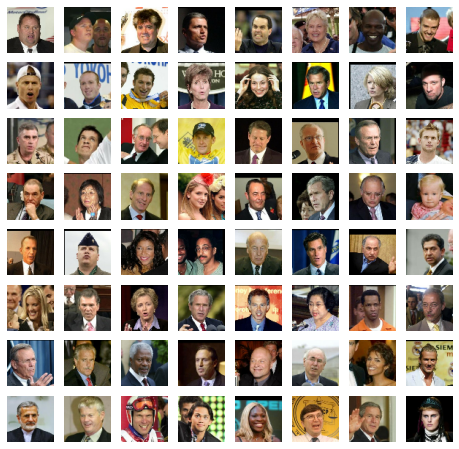

Fake: 


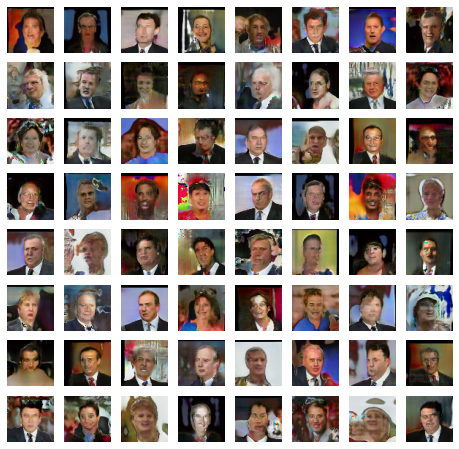

Alpha, Beta:  <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0> <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0>
Running epoch  43
Evaluating:
Epoch  43 0.58203125 -0.12640391290187836 of  64 Epochs
Real: 


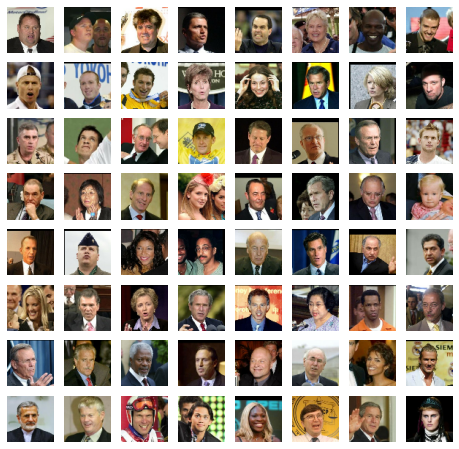

Fake: 


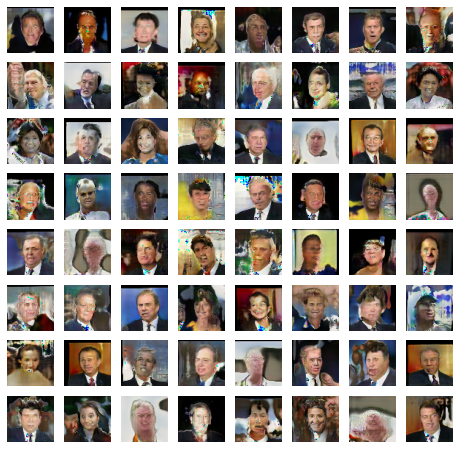

Alpha, Beta:  <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0> <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0>
Running epoch  44
Evaluating:
Epoch  44 0.66328125 0.057934046164155005 of  64 Epochs
Real: 


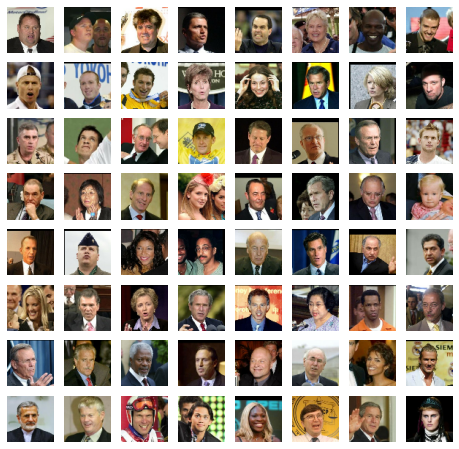

Fake: 


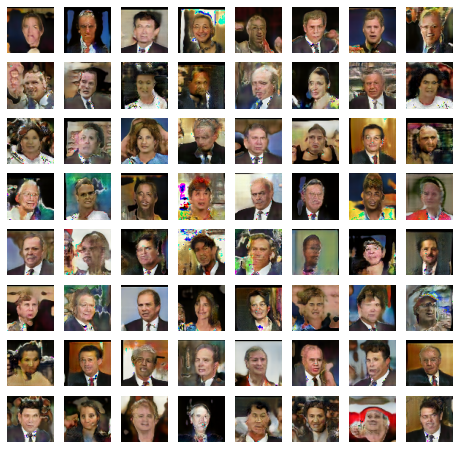

Alpha, Beta:  <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0> <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0>
Running epoch  45
Evaluating:
Epoch  45 0.52265625 -0.12206587418913842 of  64 Epochs
Real: 


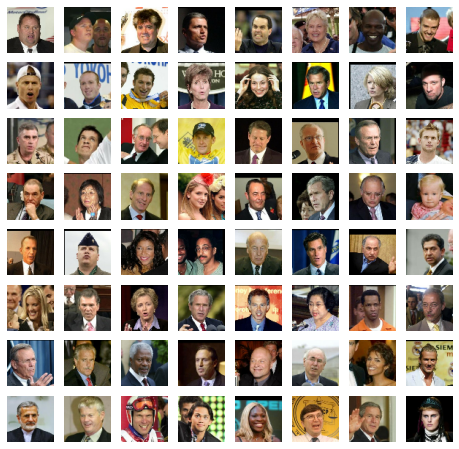

Fake: 


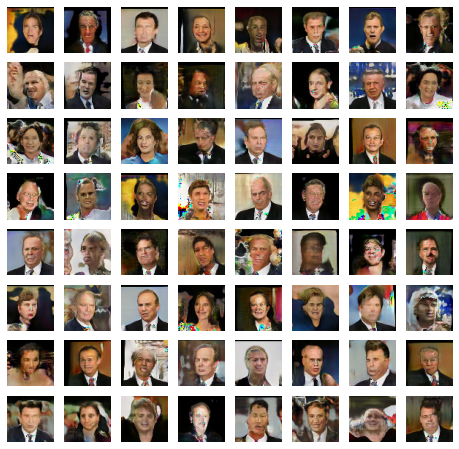

Alpha, Beta:  <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0> <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0>
Running epoch  46
Evaluating:
Epoch  46 0.51640625 0.2524402171373367 of  64 Epochs
Real: 


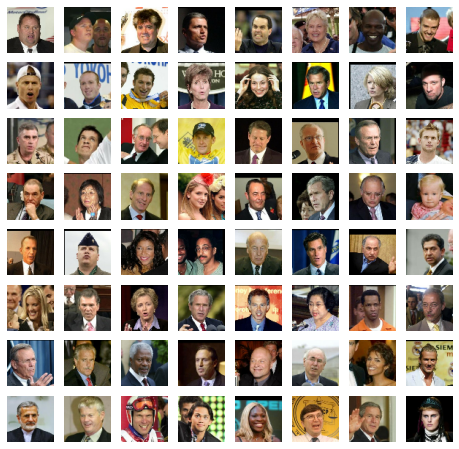

Fake: 


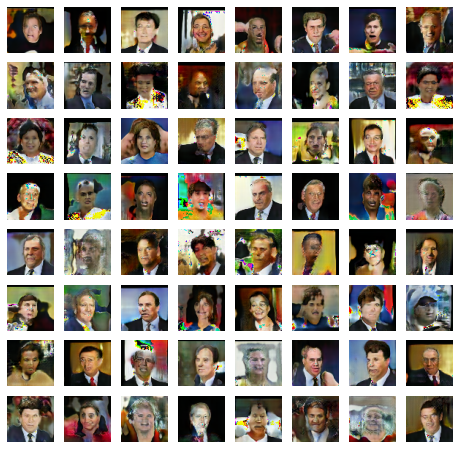

Alpha, Beta:  <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0> <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0>
Running epoch  47
Evaluating:
Epoch  47 0.60546875 0.09324728697538376 of  64 Epochs
Real: 


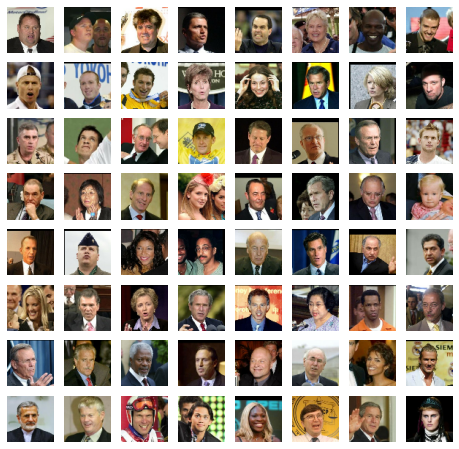

Fake: 


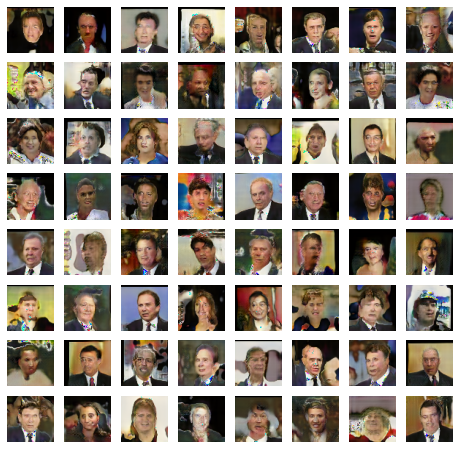

Alpha, Beta:  <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0> <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0>
Running epoch  48
Evaluating:
Epoch  48 0.5953125 0.0031929002841934563 of  64 Epochs
Real: 


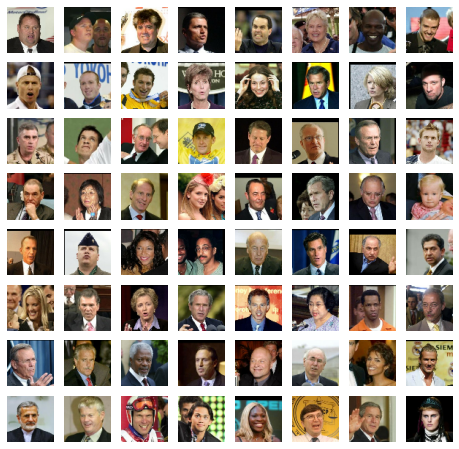

Fake: 


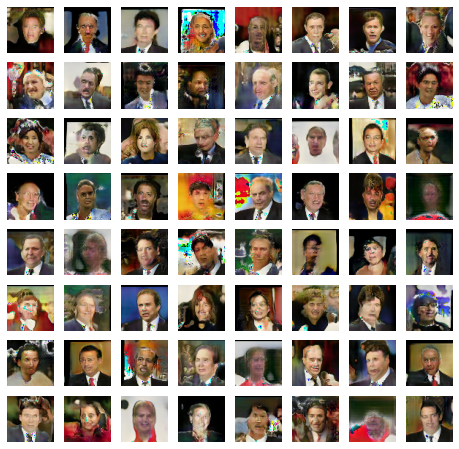

Alpha, Beta:  <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0> <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0>
Running epoch  49
Evaluating:
Epoch  49 0.56015625 -0.07617573663592339 of  64 Epochs
Real: 


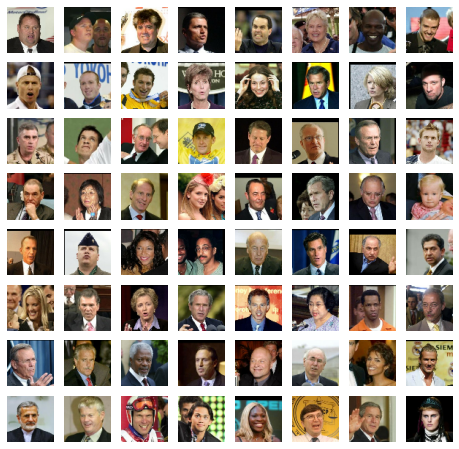

Fake: 


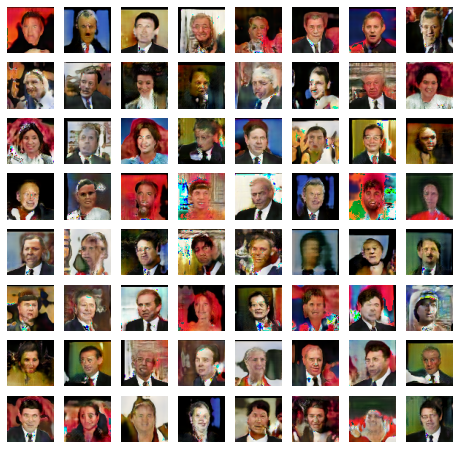

Alpha, Beta:  <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0> <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0>
Running epoch  50
Evaluating:
Epoch  50 0.52578125 0.153379388153553 of  64 Epochs
Real: 


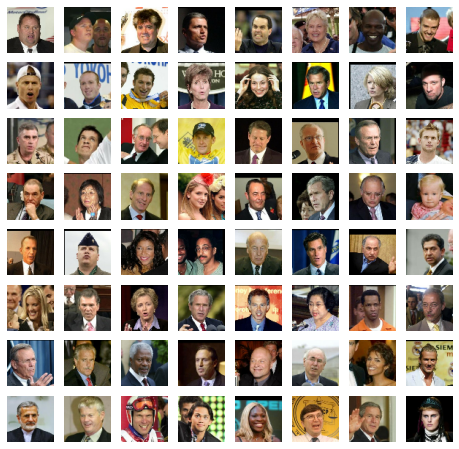

Fake: 


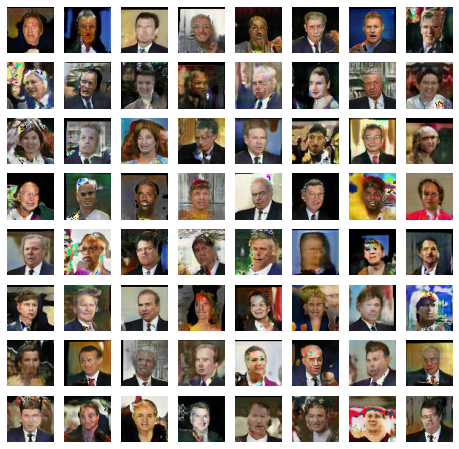

Alpha, Beta:  <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0> <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0>
Running epoch  51
Evaluating:
Epoch  51 0.5 0.30191412270069123 of  64 Epochs
Real: 


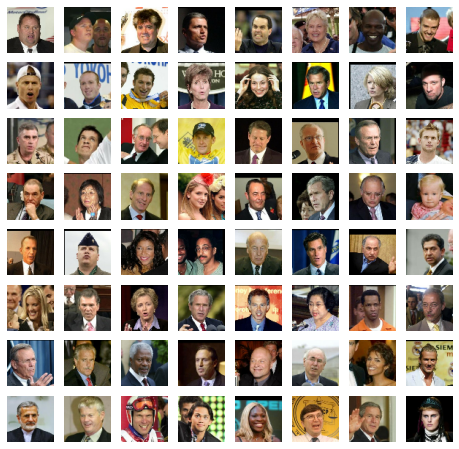

Fake: 


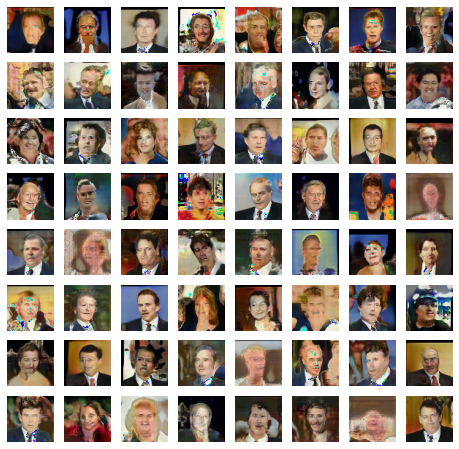

Alpha, Beta:  <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0> <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0>
Running epoch  52
Evaluating:
Epoch  52 0.53828125 0.11449333280324936 of  64 Epochs
Real: 


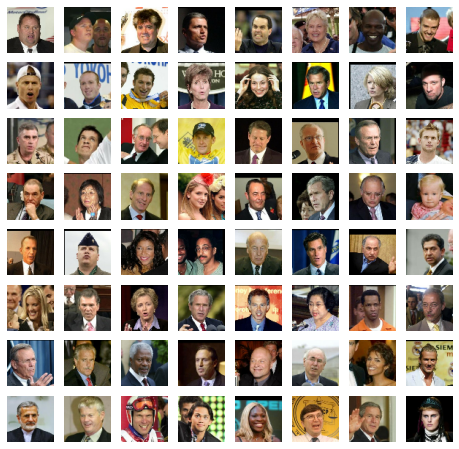

Fake: 


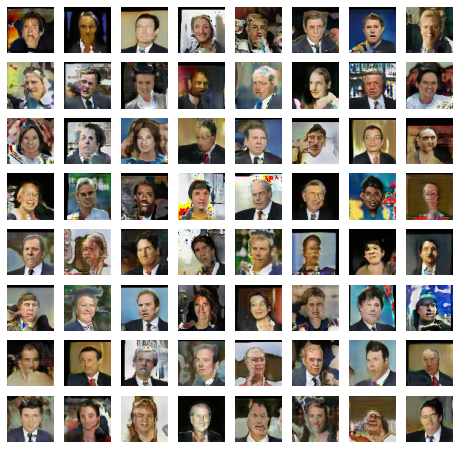

Alpha, Beta:  <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0> <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0>
Running epoch  53
Evaluating:
Epoch  53 0.55 -0.1475668579339981 of  64 Epochs
Real: 


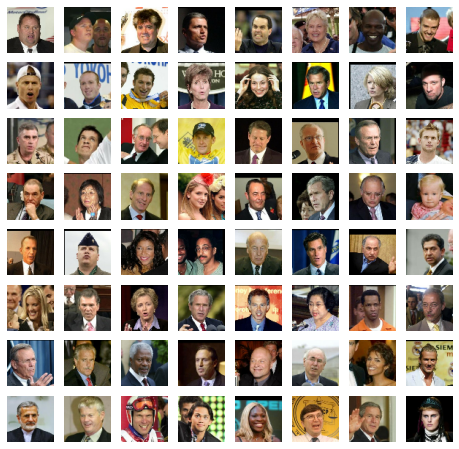

Fake: 


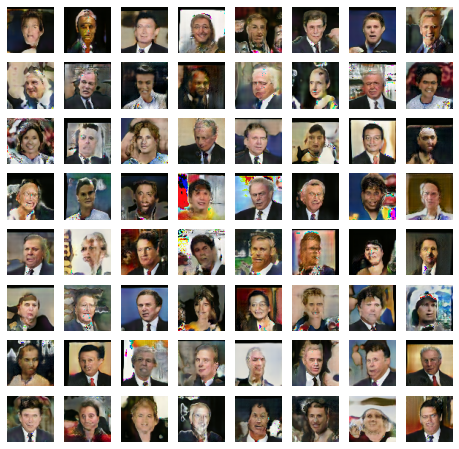

Alpha, Beta:  <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0> <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0>
Running epoch  54
Evaluating:
Epoch  54 0.51015625 0.2724386423826218 of  64 Epochs
Real: 


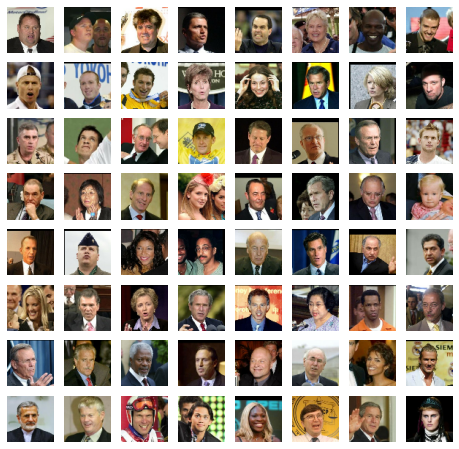

Fake: 


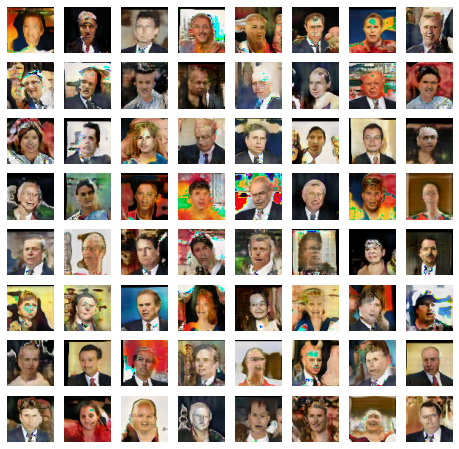

Alpha, Beta:  <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0> <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0>
Running epoch  55
Evaluating:
Epoch  55 0.54140625 -0.1324826292693615 of  64 Epochs
Real: 


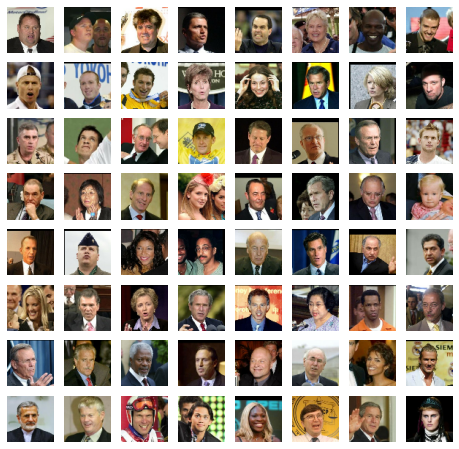

Fake: 


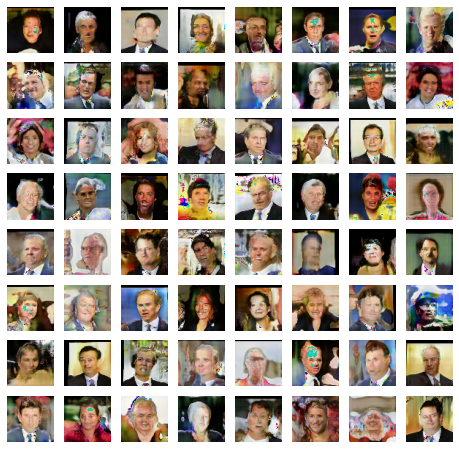

Alpha, Beta:  <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0> <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0>
Running epoch  56
Evaluating:
Epoch  56 0.51328125 0.17515089362859726 of  64 Epochs
Real: 
Buffered data was truncated after reaching the output size limit.

In [ ]:
global gen, des, enc, baseLayers
trainGan(lfw, name='New01', epochs=10, batchSize=128, hinge=False, des_steps=1, gen_steps=0, enc_steps=0, sizes=[64, 128, 256], grow=False, des_alpha=des_alpha, gen_alpha=gen_alpha)

In [ ]:
!ls '/content/gdrive/My Drive/AI Research/GANs/models/'

A01_des.h5     A02_16_gen.h5  A02_8_enc.h5   A04_4_des.h5  A04_8_gen.h5
A01_enc.h5     A02_4_des.h5   A02_8_gen.h5   A04_4_enc.h5
A01_gen.h5     A02_4_enc.h5   A04_16_des.h5  A04_4_gen.h5
A02_16_des.h5  A02_4_gen.h5   A04_16_enc.h5  A04_8_des.h5
A02_16_enc.h5  A02_8_des.h5   A04_16_gen.h5  A04_8_enc.h5


In [ ]:
# @tf.function
def trainGenEnc(gen, enc, real, batch_size, coeff=1):
  with tf.GradientTape() as enc_tape, tf.GradientTape() as gen_tape:
    real_enc = enc(real, training=True)
    enc_fake = gen(real_enc, training=True)
 
    gen_loss = generator_enc_loss(real, enc_fake) * coeff
    gradients_of_generator = gen_tape.gradient(gen_loss, gen.trainable_variables)
    generator_optimizer.apply_gradients(zip(gradients_of_generator, gen.trainable_variables))
 
    gradients_of_enc = enc_tape.gradient(gen_loss, enc.trainable_variables)
    enc_optimizer.apply_gradients(zip(gradients_of_enc, enc.trainable_variables))
 
# @tf.function
def trainDes(gen, des, real, batch_size, smooth):
  with tf.GradientTape() as disc_tape:
    noise = tf.random.normal([batch_size, 512])
 
    fake = gen(noise, training=False)
 
    X = tf.concat((fake, real), axis=0)
    
    pred = des(X, training=True)
 
    fake_output = pred[:batch_size]
    real_output = pred[batch_size:]
 
    des_loss = discriminator_loss(real_output, fake_output, smooth)
    gradients_of_discriminator = disc_tape.gradient(des_loss, des.trainable_variables)
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, des.trainable_variables))
 
# @tf.function
def trainDesGen(gen, des, real, batch_size, smooth):
  with tf.GradientTape() as disc_tape, tf.GradientTape() as gen_tape:
    noise = tf.random.normal([batch_size, 512])
    fake = gen(noise, training=True)
    X = tf.concat((fake, real), axis=0)
    pred = des(X, training=True)
 
    fake_output = pred[:batch_size]
    real_output = pred[batch_size:]
 
    des_loss = discriminator_loss(real_output, fake_output, smooth)
    gen_loss = generator_loss(fake_output, smooth)
 
    gradients_of_discriminator = disc_tape.gradient(des_loss, des.trainable_variables)
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, des.trainable_variables))
 
    gradients_of_generator = gen_tape.gradient(gen_loss, gen.trainable_variables)
    generator_optimizer.apply_gradients(zip(gradients_of_generator, gen.trainable_variables))
 
# @tf.function
def trainGen(gen, des, batch_size, smooth):
  with tf.GradientTape() as gen_tape:
    noise = tf.random.normal([batch_size, 512])
 
    fake = gen(noise, training=True)
    fake_output = des(fake, training=False)
 
    gen_loss = generator_loss(fake_output, smooth)
 
    gradients_of_generator = gen_tape.gradient(gen_loss, gen.trainable_variables)
    generator_optimizer.apply_gradients(zip(gradients_of_generator, gen.trainable_variables))
 
def evalGan(gen, des, data, batches, batch_size):
  desAcc = 0
  genLoss = 0
  for i in range(batches):
    real = data
    fake = gen.predict(tf.random.normal([batch_size, 512]))
    X = tf.concat((fake, real), axis=0)
 
    output = des.predict(X)
 
    real_output = output[batch_size:]
    fake_output = output[:batch_size]
 
    labels = tf.reshape(tf.concat((tf.zeros_like(fake_output), tf.ones_like(real_output)), axis=0), [-1])
    output = tf.reshape(output, [-1])
    
    acc = tf.keras.metrics.binary_accuracy(labels, output, threshold=0.5)
    desAcc += acc.numpy()
    # print(acc)
    genLoss += tf.reduce_sum(generator_loss(fake_output, 1)).numpy() / batch_size
  return desAcc / batches, genLoss / batches
 
def augmenter(size):
  def augment(sample):
    sample['image'] = tf.image.resize(sample['image'], [size, size], method='nearest')
    return sample
  return augment

from IPython.display import clear_output

def trainGan(data, name='A02', modeldir='/content/gdrive/My Drive/AI Research/GANs/models/', epochs=10, batch_size=5, loss='mse', smooth=1., sizes=[4, 8, 16, 32, 64, 128, 256]):
  global gen, des, enc, baseLayers
  realData = data
  # print(realData.shape)
  noise = tf.random.normal([64, 512])
  results = []
  gen_alpha, des_alpha = None, None
  for size in sizes:
    coeff = 1
    print("Input shape: ",des.input.shape)
    currentData = realData.map(augmenter(size)).batch(batch_size, drop_remainder=True).shuffle(4096).prefetch(tf.data.experimental.AUTOTUNE)
    for epoch in range(epochs):
      b = 0
      for batch in currentData:
        b += 1
        if des_alpha != None and gen_alpha != None:
          des_alpha.incrementAlpha(0.1 / ((220*60)/batch_size))
          gen_alpha.incrementAlpha(0.1 / ((220*60)/batch_size))

        real = batch['image']
        real = (tf.cast(real, tf.float32) - 127.5) / 127.5
 
        trainDes(gen, des, real, batch_size, smooth)
        trainDes(gen, des, real, batch_size, smooth)
        trainGen(gen, des, batch_size, smooth)
        trainDesGen(gen, des, real, batch_size, smooth)
        if coeff >= 0.15:
          trainGenEnc(gen, enc, real, batch_size, coeff)
        else:
          trainGenEnc(gen, enc, real, batch_size, 0.2)
        # trainDesGenEnc(gen, des, enc, real, batch_size)

      coeff *= 0.9

      fake = gen.predict(noise)
      print("Evaluating:")
      desAcc, genLoss = evalGan(gen, des, real, 10, batch_size)
      results.append({'desAcc':desAcc, 'genLoss':genLoss})
      print("Epoch ", epoch, desAcc, genLoss, "of ", epochs, "Epochs")

      print("epoch length: ", b)
      print("Real: ")
      plotImages(real)
 
      print("Fake: ")
      plotImages(fake)

      if desAcc > 0.8:
        coeff *= 2
        coeff = min(coeff, 1.)

      if des_alpha != None and gen_alpha != None:
        print("Alpha, Beta: ", gen_alpha.alpha, des_alpha.alpha)


    gen.save(modeldir + name + '_' + str(size) + '_gen.h5')
    des.save_weights(modeldir + name + '_' + str(size)  + '_des.h5')
    enc.save_weights(modeldir + name + '_' + str(size)  + '_enc.h5')
    des, enc, baseLayers, des_alpha = descriminatorAddStage(des, enc, baseLayers, freeze=False)
    gen, gen_alpha = generatorAddStage(gen, freeze=False)
    epochs *= 1.6
    epochs = int(epochs)
    clear_output(wait=True)

NameError: ignored